# Plot saved reconstruction snapshots from training



### TOC
 [1. Load data](#ld)<br>
 





In [19]:
from IPython import display

import numpy as np
# import torch
# from torch import nn
# bce = nn.BCELoss()
# from torch.optim import Adam
# from torch.autograd import Variable

# import cv2
# #from skimage.metrics import structural_similarity as ssim
import copy


In [5]:
from IPython.display import display, HTML

In [6]:
# load netcdf files directly via xarray
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy


In [116]:
# from torch import nn
# mse = nn.MSELoss()
# mae = nn.L1Loss()

# import math


In [7]:
# define internal pic res
ires = 64
res = 64
nvars = 18
mnvars = 18


In [6]:
 mnvars
    

18

<a id='ld'></a>
# Load data

In [10]:
# load per-variable scale factors
minmaxi_era = np.load('/glade/scratch/dkorytin/minmaxi_wrferaext18.npy')
minmaxi_mpi = minmaxi_era


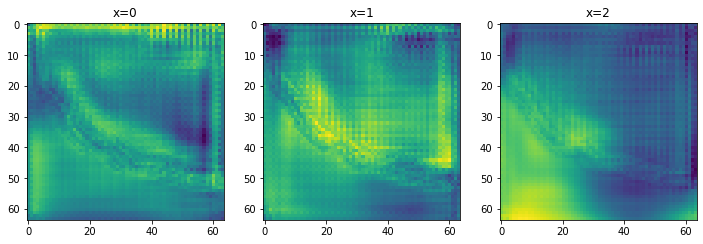

In [9]:
# Load numpy file
arr = np.load('/glade/scratch/dkorytin/unit-wnet-wrferaext18-trainer-3resblks-3ds-bse-dropout/output/ii_265000_era.npy')

import matplotlib.pyplot as plt

fig, axes = plt.subplots(1, 3, figsize=(12,4))

for x, ax in enumerate(axes):
    ax.imshow(arr[0, x, ::-1, :])
    ax.set_title(f'x={x}')

plt.show()




# Plot routines

In [16]:
def show_saved_reconstruction(ii, input_chunk, xoff=20, yoff=58):
    #input_chunk = storms[ii:ii+1, :, yoff:yoff+64, xoff:xoff+64]

    # denorm
    input_img_denorm = input_chunk * (minmaxi_era[:,1]-minmaxi_era[:,0])[np.newaxis,:,np.newaxis,np.newaxis] + minmaxi_era[:,0][np.newaxis,:,np.newaxis,np.newaxis]
    raw_era = np.array(input_img_denorm)[0]
    raw_era[np.isnan(raw_era)] = 0.   # extended surface domain has nan's at bottom
    #raw_era[8:] = (raw_era * mask)[8:]

    # ^4 prec
    raw_era[8] = raw_era[8] ** 4

    vmin = [raw_era[ii].min() for ii in range(18)]
    vmax = [raw_era[ii].max() for ii in range(18)]

    svars = [0,1,2,3,4,5,6,7,17]
    plot_9v_192x256_abs(raw_era, None, vmin, vmax, svars=svars, xoff=xoff, yoff=yoff)
    svars = [8,9,10,11,12,13,14,15,16]
    plot_9v_192x256_abs(raw_era, None, vmin, vmax, svars=svars, xoff=xoff, yoff=yoff)


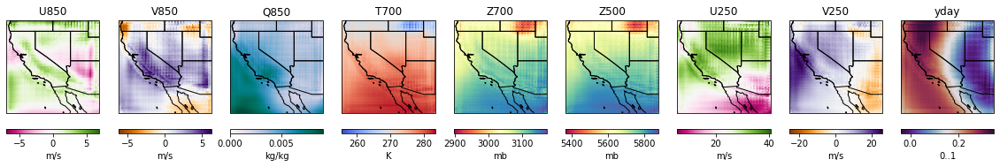

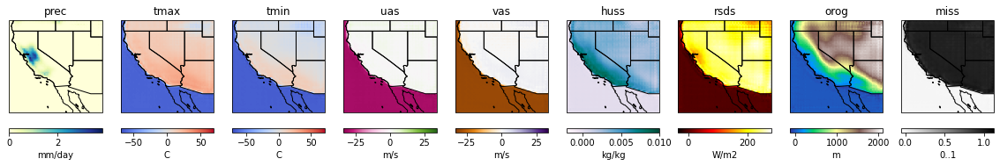

In [22]:
show_saved_reconstruction(0, arr)

In [11]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy
import cartopy.feature as cfeature
import xarray as xr

# metadata used for lat/lon backdrop
tslice = slice('1979-01-01T00:00:00', '1979-01-01T20:00:00')
d='/glade/p/ral/risc/rmccrary/CMIP5_CORDEX/NAmerica/MPI-ESM-LR/native/historical/'
dv1 = xr.open_dataset('/glade/p/ral/risc/narccap/obs/gridMET/common/rsds.gridMET.NAM-22i.nc')['rsds'].sel(time=tslice, lat=slice(13.5,61.5), lon=slice(-130,-66))
    
def plot_8v_abs_192x256(isample, modelname, vmin, vmax, yoff=0, xoff=0, yz=192, xz=256, cc=True):
#     varnames = ['U850', 'V850', 'Q850', 'T700', 'Z700', 'Z500', 'U250', 'V250']
#     units = ['m/s', 'm/s', 'kg/kg', 'K', 'mb', 'mb', 'm/s', 'm/s']
#     cmaps = ['PiYG', 'PuOr', 'cividis', 'inferno', 'viridis', 'viridis', 'PiYG', 'PuOr']
        
#     fig, axarr = plt.subplots(1, 8, figsize = (20,20))
#     for ii in range(8):
#         plot = axarr[ii].imshow(isample[ii][::-1,:], vmin=vmin[ii], vmax=vmax[ii], cmap=cmaps[ii])
#         cbar = fig.colorbar(plot, ax=axarr[ii], orientation="horizontal", fraction=0.046, pad=0.016)
#         cbar.set_label(units[ii])
#         axarr[ii].set_title(varnames[ii])
#     plt.suptitle(modelname, y=0.29, fontsize=16)
#     plt.show()
    varnames = ['U850', 'V850', 'Q850', 'T700', 'Z700', 'Z500', 'U250', 'V250']
    units = ['m/s', 'm/s', 'kg/kg', 'K', 'mb', 'mb', 'm/s', 'm/s']
    #cmaps = ['PiYG', 'PuOr', 'cividis', 'inferno', 'viridis', 'viridis', 'PiYG', 'PuOr']
    #cmaps = ['PiYG', 'PuOr', 'BrBG', 'RdBu_r', 'Spectral', 'Spectral', 'PiYG', 'PuOr']
    cmaps = ['PiYG', 'PuOr', 'PuBuGn', 'coolwarm', 'Spectral', 'Spectral', 'PiYG', 'PuOr']

    # pass by value
    vmin = copy.deepcopy(vmin)
    vmax = copy.deepcopy(vmax)
    
    # Ranges centered on zero for U, V
    vmin[0] = -max(abs(vmin[0]), abs(vmax[0]))
    vmax[0] = max(abs(vmin[0]), abs(vmax[0]))
    vmin[1] = -max(abs(vmin[1]), abs(vmax[1]))
    vmax[1] = max(abs(vmin[1]), abs(vmax[1]))

    #vmin[6] = -max(abs(vmin[6]), abs(vmax[6]))
    #vmax[6] = max(abs(vmin[6]), abs(vmax[6]))
    vmin[7] = -max(abs(vmin[7]), abs(vmax[7]))
    vmax[7] = max(abs(vmin[7]), abs(vmax[7]))
    
    # min of Q850 should be 0
    vmin[2] = 0

          
    fig, axarr = plt.subplots(1, 8, figsize = (20,20), subplot_kw={'projection': ccrs.PlateCarree()})
    lon = dv1[0].lon
    lat = dv1[0].lat

    for ii in range(8):
        
        #axarr[ii].set_title("Subplot row", fontsize=16)
        axarr[ii].coastlines()
        axarr[ii].add_feature(cfeature.STATES)
        img_extent = (lon.min(), lon.max(), lat.min(), lat.max())
        
#         # add wind barbs
#         x=[]; y=[]; u=[]; v=[]
#         for mm in range(0, 128, 20):
#             hx = []
#             for nn in range(0, 128, 20): 
#                 x.append(dv1[0][mm,nn].lon)
#                 y.append(dv1[0][mm,nn].lat)
#                 #u.append(isample[11][mm,nn]) # uas
#                 #v.append(isample[12][mm,nn]) # vas
#                 u.append(isample[0][mm,nn]) # u850
#                 v.append(isample[1][mm,nn]) # v850
#         axarr[ii].barbs(x, y, u, v, length=5, sizes=dict(emptybarb=0.25, spacing=0.2, height=0.5), linewidth=0.95)

#         # add huss850 contours
#         if cc == True:
#             x=[]; y=[];
#             for mm in range(0, 192, 1):
#                 x.append(dv1[0][mm,mm].lon)
#                 y.append(dv1[0][mm,mm].lat)
#             hx=[]; hy=[]
#             for mm in range(0, 192, 1):
#                 hx = []
#                 for nn in range(0, 256, 1):
#                     #hx.append(isample[2][mm,nn]) # q850
#                     hx.append(isample[ii][mm,nn]) # q850
#                 hy.append(hx)
#             X, Y = np.meshgrid(x, y)
#             Z = np.array(hy)
#             CS = axarr[ii].contour(X, Y, Z)
#             axarr[ii].clabel(CS, inline=True, fontsize=10)


        
        plot = axarr[ii].imshow(isample[ii][::-1,:], vmin=vmin[ii], vmax=vmax[ii], cmap=cmaps[ii], origin='upper', extent=img_extent, transform=ccrs.PlateCarree())  
        #plot = axarr[ii].imshow(isample[ii][::-1,:], vmin=vmin[ii], vmax=vmax[ii], cmap=cmaps[ii])
        cbar = fig.colorbar(plot, ax=axarr[ii], orientation="horizontal", fraction=0.046, pad=0.016)
        cbar.set_label(units[ii])
        axarr[ii].set_title(varnames[ii])
        

    plt.suptitle(modelname, y=0.26, fontsize=16)
    plt.show()





In [13]:
# tslice = slice('1979-01-01T00:00:00', '1979-01-01T20:00:00')
# mask128 = xr.open_dataset('/glade/p/ral/risc/narccap/obs/gridMET/common/rsds.gridMET.NAM-22i.nc')['rsds'].sel(time=tslice, lat=slice(20,55), lon=slice(-130,-66))[:,12:12+128,69:69+128]
# mask128np = np.array(mask128[0])
# mask128np[mask128np>0] = 1
# mask128np[np.isnan(mask128np)] = 0.

# metadata used for lat/lon backdrop
tslice = slice('1979-01-01T00:00:00', '1979-01-01T20:00:00')
d='/glade/p/ral/risc/rmccrary/CMIP5_CORDEX/NAmerica/MPI-ESM-LR/native/historical/'
dv1 = xr.open_dataset('/glade/p/ral/risc/narccap/obs/gridMET/common/rsds.gridMET.NAM-22i.nc')['rsds'].sel(time=tslice, lat=slice(13.5,61.5), lon=slice(-130,-66))

# gridmet as mask
tslice = slice('1979-01-01T00:00:00', '1979-01-01T20:00:00')
mask = xr.open_dataset('/glade/p/ral/risc/narccap/obs/gridMET/common/rsds.gridMET.NAM-22i.nc')['rsds'].sel(time=tslice, lat=slice(13.5,61.5), lon=slice(-130,-66))
mask.shape
mask = np.array(mask[0])
mask[mask>0] = 1
mask[np.isnan(mask)] = 0.


def plot_8v_abs_surf_192x256(isample, modelname, vmin, vmax, svars=[8,9,10,11,12,13,14,15], cc=False, yoff=None, xoff=None):

    varnames = ['prec', 'tmax', 'tmin', 'uas', 'vas', 'huss', 'rsds', 'orog','miss','yday']
    units = ['mm/day', 'C', 'C', 'm/s', 'm/s', 'kg/kg', 'W/m2','m','0..1', '0..1']
    #cmaps = ['PiYG', 'PuOr', 'cividis', 'inferno', 'viridis', 'viridis', 'PiYG', 'PuOr']
    #cmaps = ['BrBG', 'RdBu_r', 'RdBu_r', 'PiYG', 'PuOr', 'BrBG', 'Spectral', 'Spectral']
    #cmaps = ['PiYG', 'PuOr', 'BrBG', 'RdBu_r', 'Spectral', 'Spectral', 'PiYG', 'PuOr']
    #cmaps = ['YlGnBu', 'coolwarm', 'coolwarm', 'PiYG', 'PuOr', 'PuBuGn', 'Spectral', 'Spectral']
    #cmaps = ['YlGnBu','coolwarm','coolwarm','PiYG','PuOr','PuBuGn','Spectral_r','Spectral','Spectral','Spectral']
    cmaps = ['YlGnBu','coolwarm','coolwarm','PiYG','PuOr','PuBuGn','hot','terrain','binary','twilight_shifted']

    # if given 64x64, place it in zeros(192,256)
    if isample.shape == (18, 64, 64):
        zz = np.zeros((18, 192, 256))
        zz[0:18, yoff:yoff+64, xoff:xoff+64] = isample
        isample = zz
    
    # pass by value
    vmin = copy.deepcopy(vmin)
    vmax = copy.deepcopy(vmax)
    
    # Ranges centered on zero for U, V
    vmin[3+8] = -max(abs(vmin[3+8]), abs(vmax[3+8]))
    vmax[3+8] = max(abs(vmin[3+8]), abs(vmax[3+8]))
    vmin[4+8] = -max(abs(vmin[4+8]), abs(vmax[4+8]))
    vmax[4+8] = max(abs(vmin[4+8]), abs(vmax[4+8]))
 
    # Ranges centered on zero for tmin, tmax
    vmin[1+8] = -max(abs(vmin[1+8]), abs(vmax[1+8]))
    vmax[1+8] = max(abs(vmin[1+8]), abs(vmax[1+8]))
    vmin[2+8] = -max(abs(vmin[2+8]), abs(vmax[2+8]))
    vmax[2+8] = max(abs(vmin[2+8]), abs(vmax[2+8]))
    
    # prec min should be 0
    vmin[8] = 0

    # Plot borders
    fig, axarr = plt.subplots(1, 8, figsize = (20,20), subplot_kw={'projection': ccrs.PlateCarree()})
    #lon = dv1[0].lon
    #lat = dv1[0].lat
    lon = dv1[0].lon
    lat = dv1[0].lat
    
    # Plot 128x128 or 64x64 if offset is provideed
    if xoff and yoff:
        lon = dv1[0][yoff:yoff+64, xoff:xoff+64].lon
        lat = dv1[0][yoff:yoff+64, xoff:xoff+64].lat

    for ii in range(8):
        
        #axarr[ii].set_title("Subplot row", fontsize=16)
        axarr[ii].coastlines()
        axarr[ii].add_feature(cfeature.STATES)
        img_extent = (lon.min(), lon.max(), lat.min(), lat.max())
        
        # add huss850 contours
        if cc == True:
            x=[]; y=[];
            for mm in range(0, 128, 1):
                x.append(dv1[0][mm,mm].lon)
                y.append(dv1[0][mm,mm].lat)
            hx=[]; hy=[]
            for mm in range(0, 128, 1):
                hx = []
                for nn in range(0, 128, 1):
                    #hx.append(isample[2][mm,nn]) # q850
                    hx.append(isample[ii+8][mm,nn]) # q850
                hy.append(hx)
            X, Y = np.meshgrid(x, y)
            Z = np.array(hy)
            CS = axarr[ii].contour(X, Y, Z)
            axarr[ii].clabel(CS, inline=True, fontsize=10)


        # mask
        if 0 and svars[ii] != 15:   # orog not masked
            #image = isample[ii+8] * (1-dv15[0,:,:])
            image = isample[svars[ii]] * mask
            
        else:
            image = isample[svars[ii]] 
        
        # Plot 128x128 or 64x64 if offset is provideed
        if xoff and yoff:
            plot = axarr[ii].imshow(image[yoff:yoff+64, xoff:xoff+64][::-1,:], vmin=vmin[svars[ii]], vmax=vmax[svars[ii]], cmap=cmaps[svars[ii]-8], origin='upper', extent=img_extent, transform=ccrs.PlateCarree())  
        else:
            plot = axarr[ii].imshow(image[::-1,:], vmin=vmin[svars[ii]], vmax=vmax[svars[ii]], cmap=cmaps[svars[ii]-8], origin='upper', extent=img_extent, transform=ccrs.PlateCarree())  
        #plot = axarr[ii].imshow(isample[ii][::-1,:], vmin=vmin[ii], vmax=vmax[ii], cmap=cmaps[ii])
        cbar = fig.colorbar(plot, ax=axarr[ii], orientation="horizontal", fraction=0.046, pad=0.016)
        cbar.set_label(units[svars[ii]-8])
        axarr[ii].set_title(varnames[svars[ii]-8])
        
    if xoff and yoff:
        plt.suptitle(modelname, y=0.28, fontsize=16) # 64x64
    else:
        plt.suptitle(modelname, y=0.26, fontsize=16)

    plt.show()


In [14]:
# tslice = slice('1979-01-01T00:00:00', '1979-01-01T20:00:00')
# mask128 = xr.open_dataset('/glade/p/ral/risc/narccap/obs/gridMET/common/rsds.gridMET.NAM-22i.nc')['rsds'].sel(time=tslice, lat=slice(20,55), lon=slice(-130,-66))[:,12:12+128,69:69+128]
# mask128np = np.array(mask128[0])
# mask128np[mask128np>0] = 1
# mask128np[np.isnan(mask128np)] = 0.

# metadata used for lat/lon backdrop
tslice = slice('1979-01-01T00:00:00', '1979-01-01T20:00:00')
d='/glade/p/ral/risc/rmccrary/CMIP5_CORDEX/NAmerica/MPI-ESM-LR/native/historical/'
dv1 = xr.open_dataset('/glade/p/ral/risc/narccap/obs/gridMET/common/rsds.gridMET.NAM-22i.nc')['rsds'].sel(time=tslice, lat=slice(13.5,61.5), lon=slice(-130,-66))

# gridmet as mask
tslice = slice('1979-01-01T00:00:00', '1979-01-01T20:00:00')
mask = xr.open_dataset('/glade/p/ral/risc/narccap/obs/gridMET/common/rsds.gridMET.NAM-22i.nc')['rsds'].sel(time=tslice, lat=slice(13.5,61.5), lon=slice(-130,-66))
mask.shape
mask = np.array(mask[0])
mask[mask>0] = 1
mask[np.isnan(mask)] = 0.


def plot_9v_192x256_abs(isample, modelname, vmin, vmax, svars=[8,9,10,11,12,13,14,15], cc=False, yoff=None, xoff=None, titles=None):

    varnames = ['U850', 'V850', 'Q850', 'T700', 'Z700', 'Z500', 'U250', 'V250', 'prec', 'tmax', 'tmin', 'uas', 'vas', 'huss', 'rsds', 'orog','miss','yday']
    if titles != None:
        varnames = titles
    units = ['m/s', 'm/s', 'kg/kg', 'K', 'mb', 'mb', 'm/s', 'm/s', 'mm/day', 'C', 'C', 'm/s', 'm/s', 'kg/kg', 'W/m2','m','0..1', '0..1']
    cmaps = ['PiYG', 'PuOr', 'PuBuGn', 'coolwarm', 'Spectral', 'Spectral', 'PiYG', 'PuOr', 'YlGnBu','coolwarm','coolwarm','PiYG','PuOr','PuBuGn','hot','terrain','binary','twilight_shifted']

    # if given 64x64, place it in zeros(192,256)
    if isample.shape == (18, 64, 64):
        zz = np.zeros((18, 192, 256))
        zz[0:18, yoff:yoff+64, xoff:xoff+64] = isample
        isample = zz
    
    # pass by value
    vmin = copy.deepcopy(vmin)
    vmax = copy.deepcopy(vmax)
    
    # Ranges centered on zero for U850, V850
    vmin[0] = -max(abs(vmin[0]), abs(vmax[0]))
    vmax[0] = max(abs(vmin[0]), abs(vmax[0]))
    vmin[1] = -max(abs(vmin[1]), abs(vmax[1]))
    vmax[1] = max(abs(vmin[1]), abs(vmax[1]))

    vmin[7] = -max(abs(vmin[7]), abs(vmax[7]))
    vmax[7] = max(abs(vmin[7]), abs(vmax[7]))
    
    # min of Q850 should be 0
    vmin[2] = 0

    
    # Ranges centered on zero for U, V
    vmin[3+8] = -max(abs(vmin[3+8]), abs(vmax[3+8]))
    vmax[3+8] = max(abs(vmin[3+8]), abs(vmax[3+8]))
    vmin[4+8] = -max(abs(vmin[4+8]), abs(vmax[4+8]))
    vmax[4+8] = max(abs(vmin[4+8]), abs(vmax[4+8]))
 
    # Ranges centered on zero for tmin, tmax
    vmin[1+8] = -max(abs(vmin[1+8]), abs(vmax[1+8]))
    vmax[1+8] = max(abs(vmin[1+8]), abs(vmax[1+8]))
    vmin[2+8] = -max(abs(vmin[2+8]), abs(vmax[2+8]))
    vmax[2+8] = max(abs(vmin[2+8]), abs(vmax[2+8]))
    
    # prec min should be 0
    vmin[8] = 0

    # Plot borders
    fig, axarr = plt.subplots(1, 9, figsize = (20,20), subplot_kw={'projection': ccrs.PlateCarree()})
    lon = dv1[0].lon
    lat = dv1[0].lat
    
    # Plot 128x128 or 64x64 if offset is provideed
    if xoff and yoff:
        lon = dv1[0][yoff:yoff+64, xoff:xoff+64].lon
        lat = dv1[0][yoff:yoff+64, xoff:xoff+64].lat

    for ii in range(9):
        
        #axarr[ii].set_title("Subplot row", fontsize=16)
        axarr[ii].coastlines()
        axarr[ii].add_feature(cfeature.STATES)
        img_extent = (lon.min(), lon.max(), lat.min(), lat.max())
        
        # add huss850 contours
        if cc == True:
            x=[]; y=[];
            for mm in range(0, 128, 1):
                x.append(dv1[0][mm,mm].lon)
                y.append(dv1[0][mm,mm].lat)
            hx=[]; hy=[]
            for mm in range(0, 128, 1):
                hx = []
                for nn in range(0, 128, 1):
                    #hx.append(isample[2][mm,nn]) # q850
                    hx.append(isample[ii+8][mm,nn]) # q850
                hy.append(hx)
            X, Y = np.meshgrid(x, y)
            Z = np.array(hy)
            CS = axarr[ii].contour(X, Y, Z)
            axarr[ii].clabel(CS, inline=True, fontsize=10)


        # mask
        if 0 and svars[ii] != 15:   # orog not masked
            #image = isample[ii+8] * (1-dv15[0,:,:])
            image = isample[svars[ii]] * mask
            
        else:
            image = isample[svars[ii]] 
        
        # Plot 128x128 or 64x64 if offset is provideed
        if xoff and yoff:
            plot = axarr[ii].imshow(image[yoff:yoff+64, xoff:xoff+64][::-1,:], vmin=vmin[svars[ii]], vmax=vmax[svars[ii]], cmap=cmaps[svars[ii]], origin='upper', extent=img_extent, transform=ccrs.PlateCarree())  
        else:
            plot = axarr[ii].imshow(image[::-1,:], vmin=vmin[svars[ii]], vmax=vmax[svars[ii]], cmap=cmaps[svars[ii]], origin='upper', extent=img_extent, transform=ccrs.PlateCarree())  
        #plot = axarr[ii].imshow(isample[ii][::-1,:], vmin=vmin[ii], vmax=vmax[ii], cmap=cmaps[ii])
        cbar = fig.colorbar(plot, ax=axarr[ii], orientation="horizontal", fraction=0.046, pad=0.016)
        cbar.set_label(units[svars[ii]])
        axarr[ii].set_title(varnames[svars[ii]])
        
    if xoff and yoff:
        plt.suptitle(modelname, y=0.28, fontsize=16) # 64x64
    else:
        plt.suptitle(modelname, y=0.26, fontsize=16)

    plt.show()


In [15]:
# tslice = slice('1979-01-01T00:00:00', '1979-01-01T20:00:00')
# mask128 = xr.open_dataset('/glade/p/ral/risc/narccap/obs/gridMET/common/rsds.gridMET.NAM-22i.nc')['rsds'].sel(time=tslice, lat=slice(20,55), lon=slice(-130,-66))[:,12:12+128,69:69+128]
# mask128np = np.array(mask128[0])
# mask128np[mask128np>0] = 1
# mask128np[np.isnan(mask128np)] = 0.

# metadata used for lat/lon backdrop
tslice = slice('1979-01-01T00:00:00', '1979-01-01T20:00:00')
d='/glade/p/ral/risc/rmccrary/CMIP5_CORDEX/NAmerica/MPI-ESM-LR/native/historical/'
dv1 = xr.open_dataset('/glade/p/ral/risc/narccap/obs/gridMET/common/rsds.gridMET.NAM-22i.nc')['rsds'].sel(time=tslice, lat=slice(13.5,61.5), lon=slice(-130,-66))

# gridmet as mask
tslice = slice('1979-01-01T00:00:00', '1979-01-01T20:00:00')
mask = xr.open_dataset('/glade/p/ral/risc/narccap/obs/gridMET/common/rsds.gridMET.NAM-22i.nc')['rsds'].sel(time=tslice, lat=slice(13.5,61.5), lon=slice(-130,-66))
mask.shape
mask = np.array(mask[0])
mask[mask>0] = 1
mask[np.isnan(mask)] = 0.


def plot_9v_192x256(isample, modelname, vmin, vmax, svars=[8,9,10,11,12,13,14,15], cc=False, yoff=None, xoff=None, titles=None):

    varnames = ['U850', 'V850', 'Q850', 'T700', 'Z700', 'Z500', 'U250', 'V250', 'prec', 'tmax', 'tmin', 'uas', 'vas', 'huss', 'rsds', 'orog','miss','yday']
    if titles != None:
        varnames = titles
    units = ['m/s', 'm/s', 'kg/kg', 'K', 'mb', 'mb', 'm/s', 'm/s', 'mm/day', 'C', 'C', 'm/s', 'm/s', 'kg/kg', 'W/m2','m','0..1', '0..1']
    cmaps = ['PiYG', 'PuOr', 'BrBG', 'coolwarm', 'Spectral', 'Spectral', 'PiYG', 'PuOr', 'twilight_shifted_r','coolwarm','coolwarm','PiYG','PuOr','BrBG','RdGy_r','terrain','RdYlGn','RdYlGn']

    # if given 64x64, place it in zeros(192,256)
    if isample.shape == (18, 64, 64):
        zz = np.zeros((18, 192, 256))
        zz[0:18, yoff:yoff+64, xoff:xoff+64] = isample
        isample = zz
    
    # pass by value
    vmin = copy.deepcopy(vmin)
    vmax = copy.deepcopy(vmax)
    
  
    for ii in range(18):
        vmin[ii] = -max(abs(vmin[ii]), abs(vmax[ii]))
        vmax[ii] = max(abs(vmin[ii]), abs(vmax[ii]))

   

    # Plot borders
    fig, axarr = plt.subplots(1, 9, figsize = (20,20), subplot_kw={'projection': ccrs.PlateCarree()})
    lon = dv1[0].lon
    lat = dv1[0].lat
    
    # Plot 128x128 or 64x64 if offset is provideed
    if xoff and yoff:
        lon = dv1[0][yoff:yoff+64, xoff:xoff+64].lon
        lat = dv1[0][yoff:yoff+64, xoff:xoff+64].lat

    for ii in range(9):
        
        #axarr[ii].set_title("Subplot row", fontsize=16)
        axarr[ii].coastlines()
        axarr[ii].add_feature(cfeature.STATES)
        img_extent = (lon.min(), lon.max(), lat.min(), lat.max())
        
        # add huss850 contours
        if cc == True:
            x=[]; y=[];
            for mm in range(0, 128, 1):
                x.append(dv1[0][mm,mm].lon)
                y.append(dv1[0][mm,mm].lat)
            hx=[]; hy=[]
            for mm in range(0, 128, 1):
                hx = []
                for nn in range(0, 128, 1):
                    #hx.append(isample[2][mm,nn]) # q850
                    hx.append(isample[ii+8][mm,nn]) # q850
                hy.append(hx)
            X, Y = np.meshgrid(x, y)
            Z = np.array(hy)
            CS = axarr[ii].contour(X, Y, Z)
            axarr[ii].clabel(CS, inline=True, fontsize=10)


        # mask
        if 0 and svars[ii] != 15:   # orog not masked
            #image = isample[ii+8] * (1-dv15[0,:,:])
            image = isample[svars[ii]] * mask
            
        else:
            image = isample[svars[ii]] 
        
        # Plot 128x128 or 64x64 if offset is provideed
        if xoff and yoff:
            plot = axarr[ii].imshow(image[yoff:yoff+64, xoff:xoff+64][::-1,:], vmin=vmin[svars[ii]], vmax=vmax[svars[ii]], cmap=cmaps[svars[ii]], origin='upper', extent=img_extent, transform=ccrs.PlateCarree())  
        else:
            plot = axarr[ii].imshow(image[::-1,:], vmin=vmin[svars[ii]], vmax=vmax[svars[ii]], cmap=cmaps[svars[ii]], origin='upper', extent=img_extent, transform=ccrs.PlateCarree())  
        #plot = axarr[ii].imshow(isample[ii][::-1,:], vmin=vmin[ii], vmax=vmax[ii], cmap=cmaps[ii])
        cbar = fig.colorbar(plot, ax=axarr[ii], orientation="horizontal", fraction=0.046, pad=0.016)
        cbar.set_label(units[svars[ii]])
        axarr[ii].set_title(varnames[svars[ii]])
        
    if modelname != None:
        if xoff and yoff:
            plt.suptitle(modelname, y=0.28, fontsize=16) # 64x64
        else:
            plt.suptitle(modelname, y=0.26, fontsize=16)

    plt.show()


In [23]:
n = 42
padded_str = str(n).zfill(6)
print(padded_str)


000042


In [35]:
# 0-mean
era_mean = np.array([0.535485  , 0.4519444 , 0.28083166, 0.6958344 , 0.74353546,
        0.7667949 , 0.45282447, 0.53518105, 0.02868525, 0.3436686 ,
        0.32084906, 0.27729246, 0.26444143, 0.06457039, 0.1160536 ,
        0.11771968, 0.27282715, 0.4996573 ], dtype='float32')


In [41]:
# for ii in range(1, 200):
    
#     #padded_str = str(ii*5000).zfill(6)
#     padded_str = str(ii*10000)
    
#     print(padded_str)
    
#     # Load numpy file
#     arr = np.load('/glade/scratch/dkorytin/unit-wnet-wrferaext18-trainer-3resblks-3ds-bse-dropout/output/ii_'+padded_str+'_era.npy')

#     # 0 mean
#     #arr = np.load('/glade/scratch/dkorytin/unit-wnet-wrferaext18-mean0-trainer-3resblks-3ds-bse-dropout/output/ii_'+padded_str+'_era.npy')
#     #arr += era_mean.reshape((1, 18, 1, 1))
        
#     show_saved_reconstruction(0, arr)

In [42]:
import csv

['100', '0.029339326545596123', '0.034996263682842255']


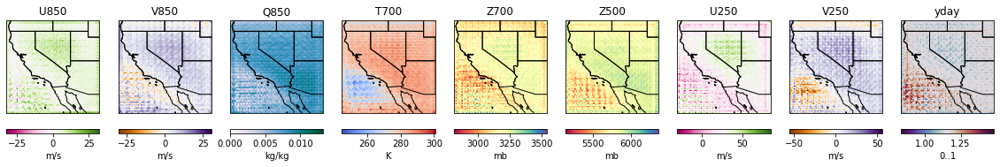

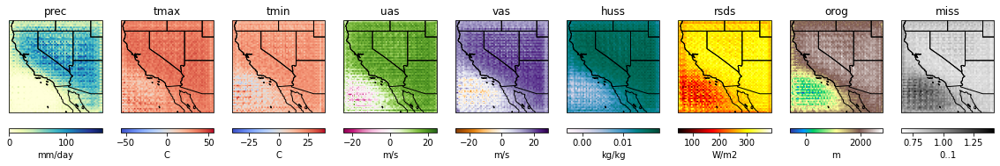

['500', '0.008939744904637337', '0.015412777662277222']


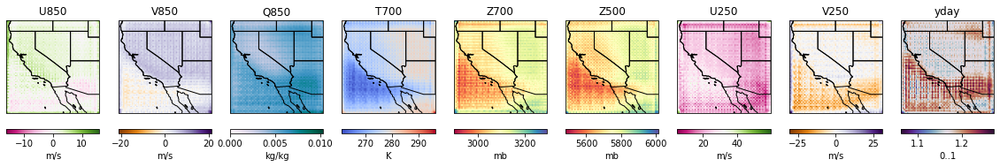

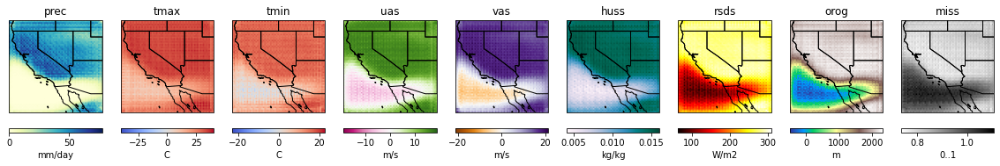

['1000', '0.009893006645143032', '0.011903940699994564']


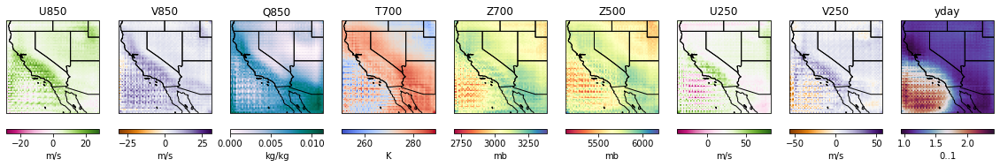

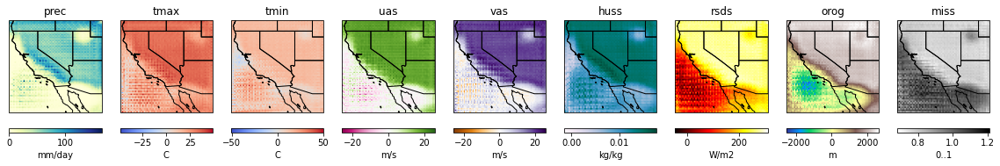

['2000', '0.016180505976080894', '0.015715280547738075']


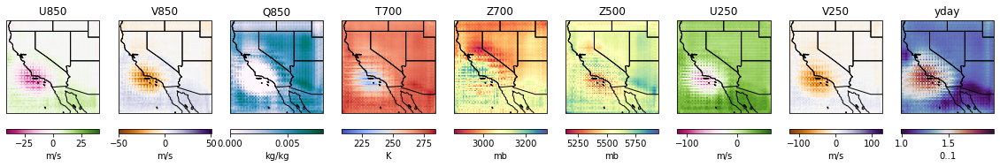

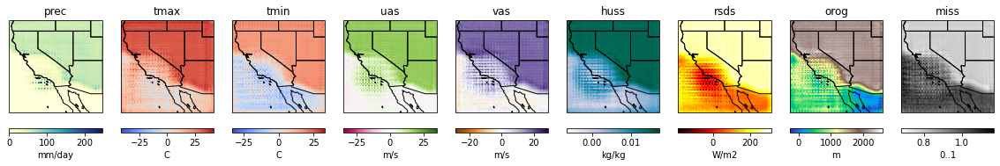

['5000', '0.007201570551842451', '0.010087503120303154']


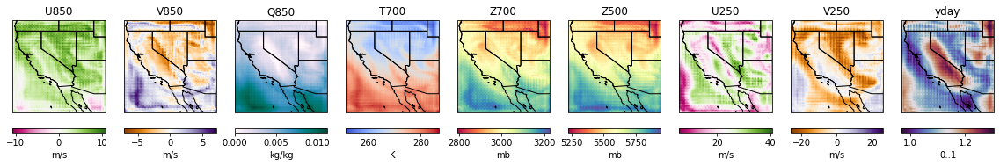

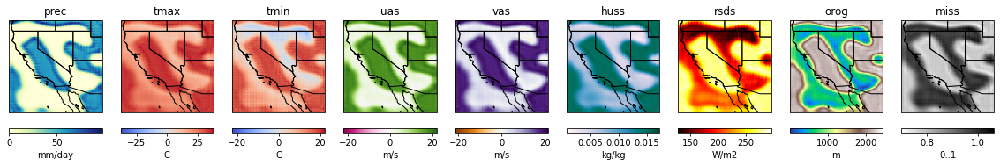

['10000', '0.004761273041367531', '0.004733864683657885']


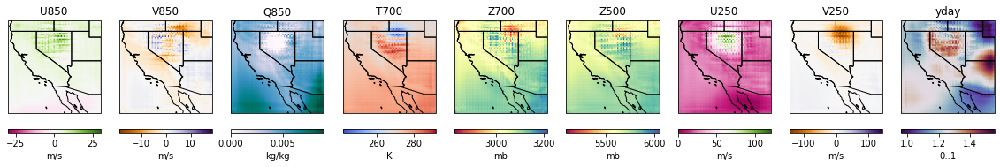

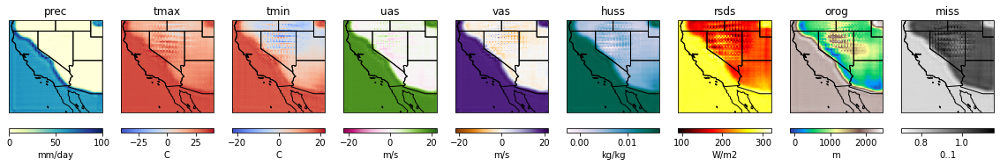

['15000', '0.004445753991603851', '0.0032765837386250496']


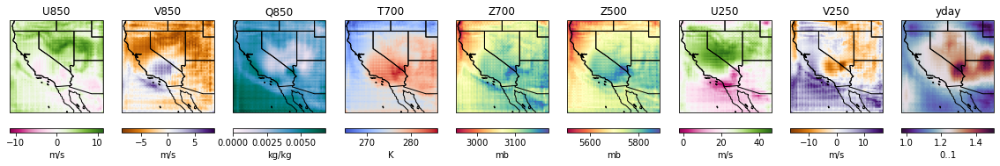

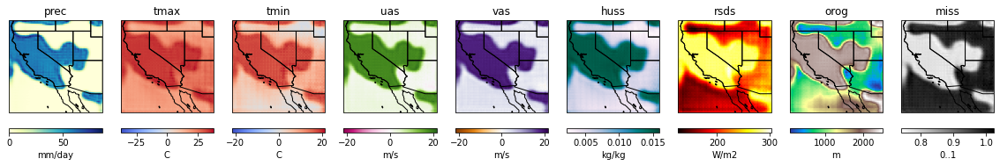

['20000', '0.00594500545412302', '0.0037767556495964527']


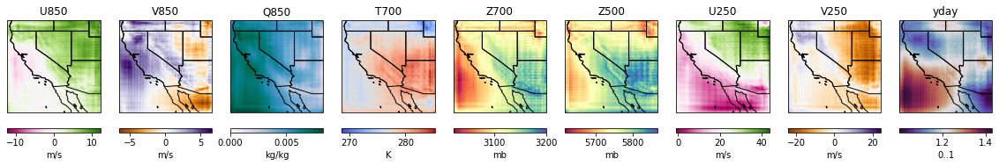

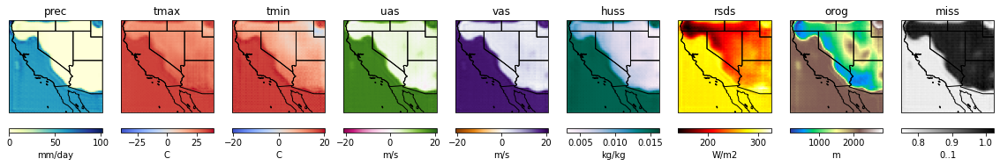

['25000', '0.05969088524580002', '0.03358956053853035']


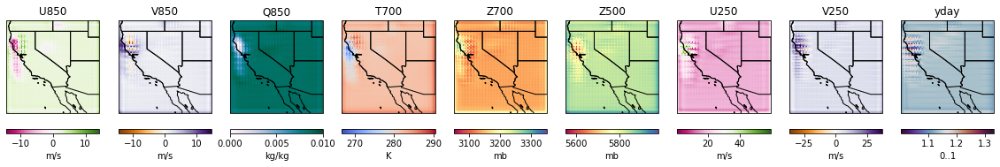

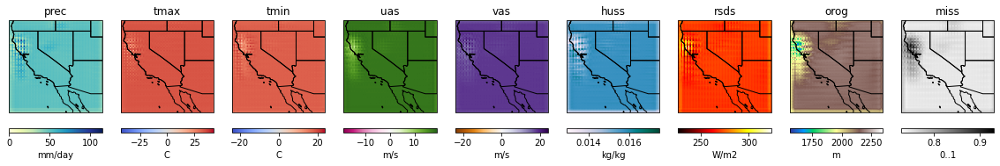

['30000', '0.06573355197906494', '0.02054058201611042']


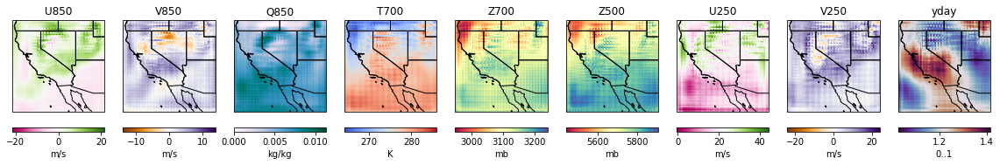

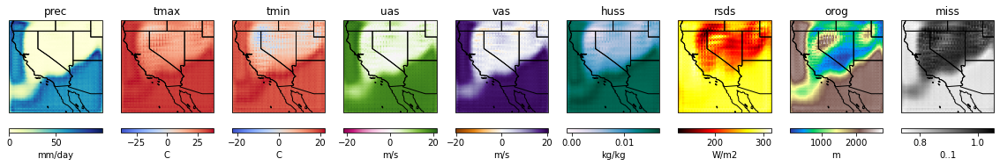

['35000', '0.022788921371102333', '0.014616817235946655']


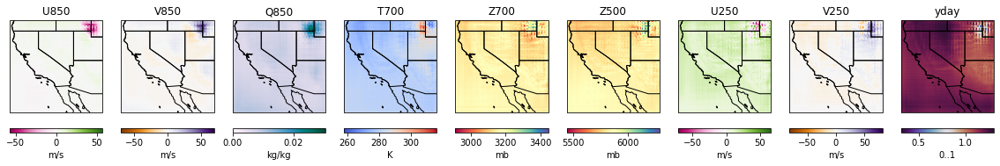

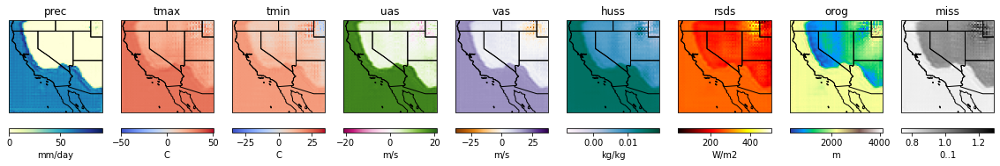

['40000', '0.0075650629587471485', '0.006734180264174938']


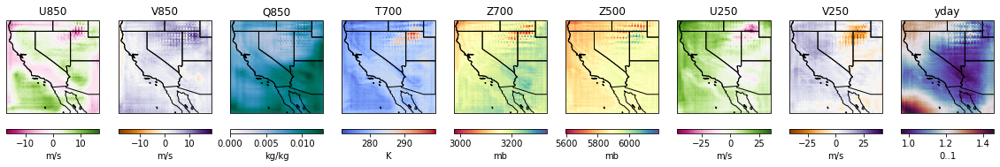

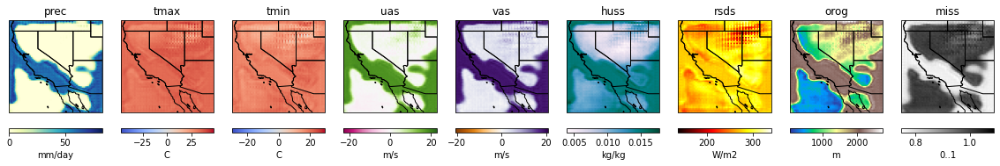

['45000', '0.008810595609247684', '0.005541135091334581']


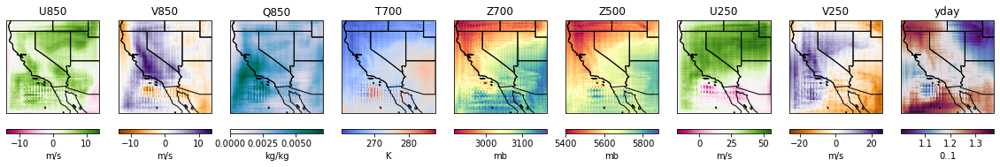

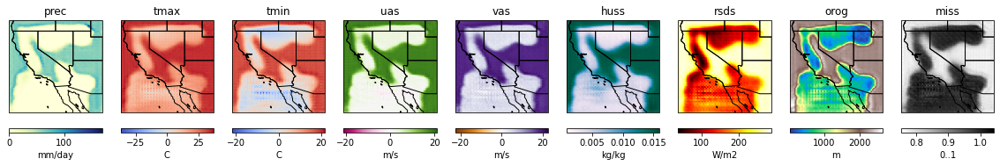

['50000', '0.008824829943478107', '0.0068770600482821465']


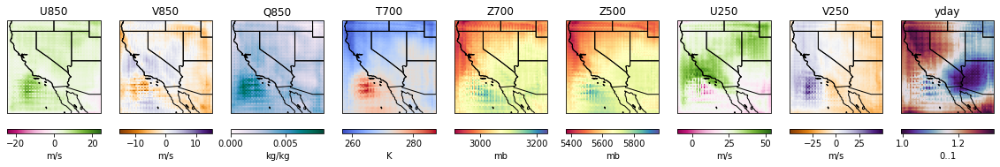

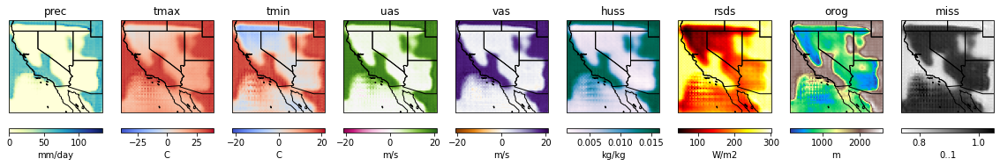

['55000', '0.013423265889286995', '0.038128532469272614']


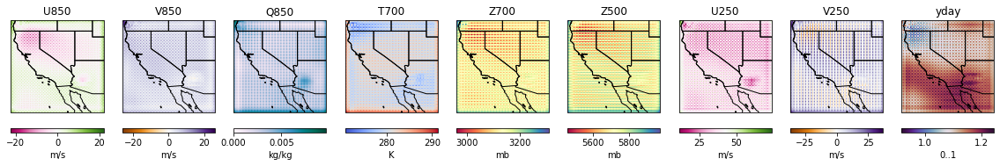

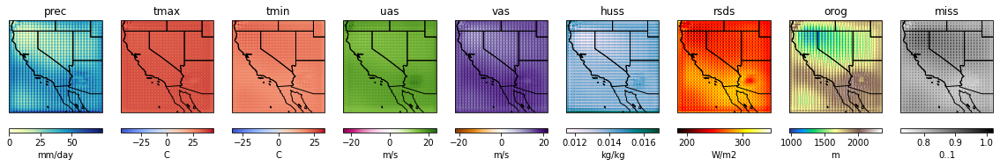

['60000', '0.008157331496477127', '0.014193179085850716']


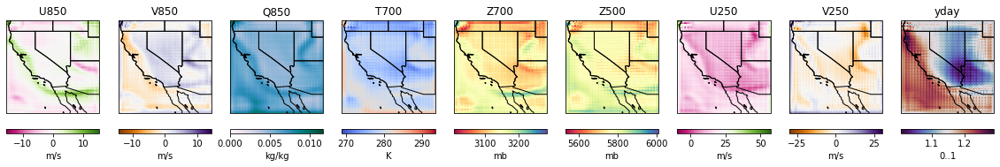

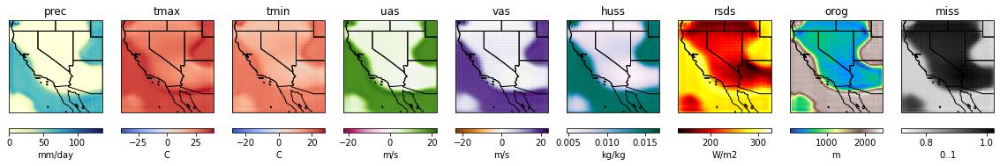

['65000', '0.008112047798931599', '0.009068725630640984']


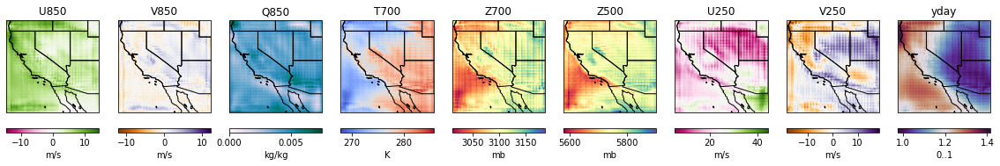

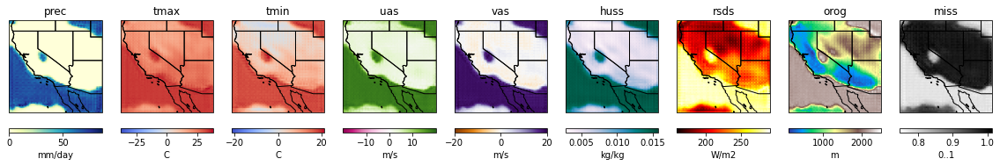

['70000', '0.006321983877569437', '0.006969738285988569']


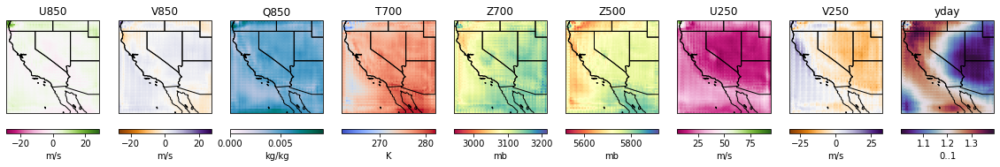

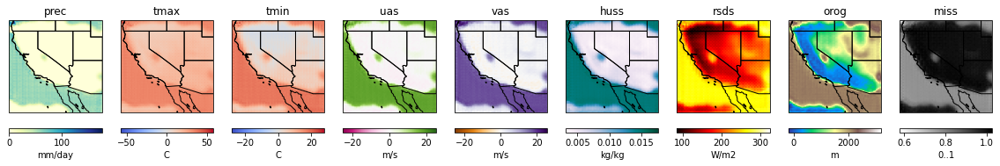

['75000', '0.014550368301570415', '0.03155454620718956']


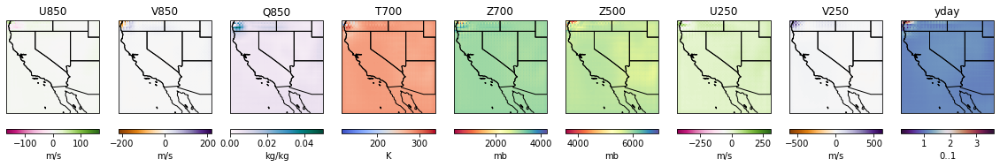

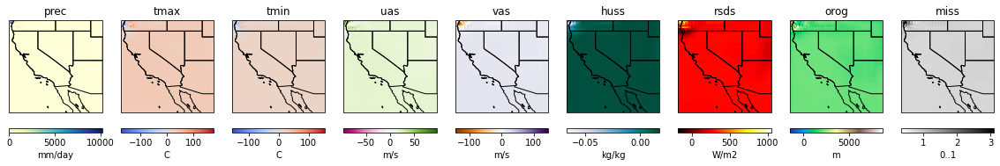

['80000', '0.028370235115289688', '0.024335268884897232']


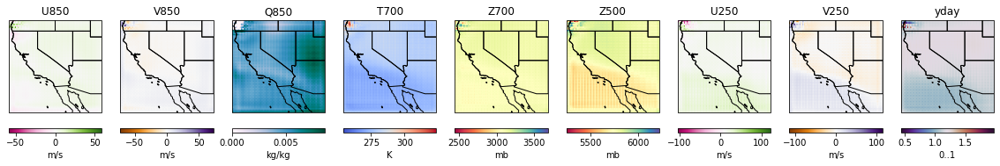

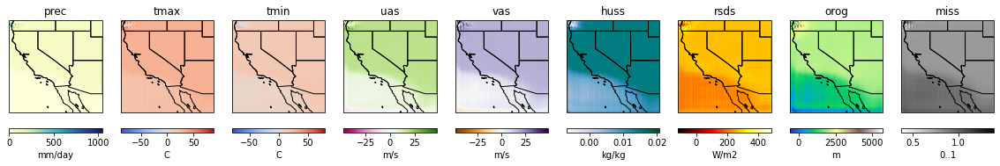

['85000', '0.0556032657623291', '0.16088144481182098']


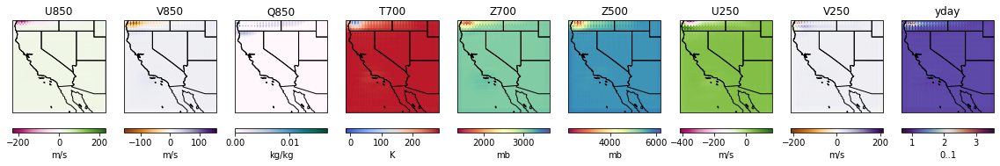

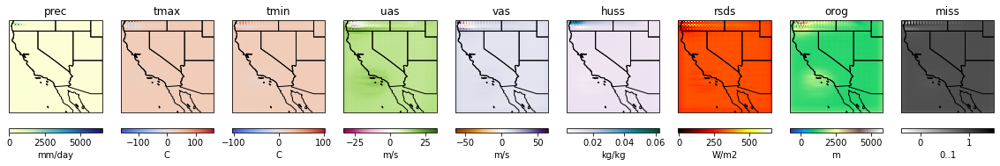

['90000', '0.0429072380065918', '0.026549333706498146']


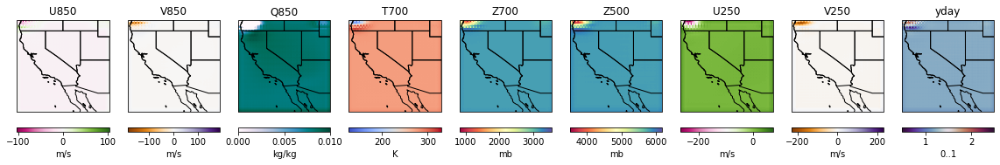

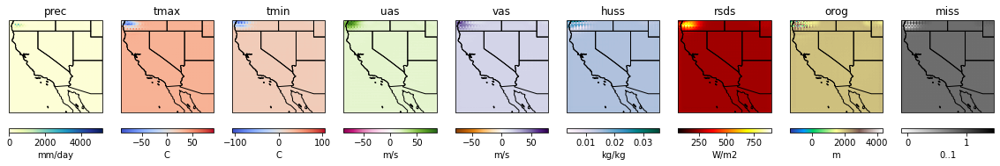

['95000', '0.06620953232049942', '0.03693506494164467']


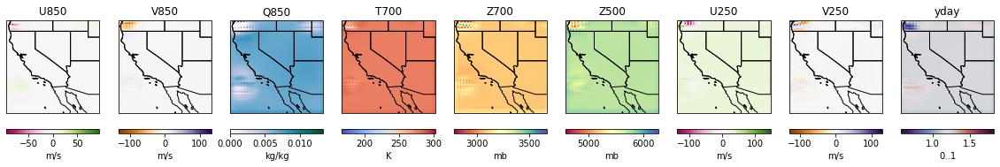

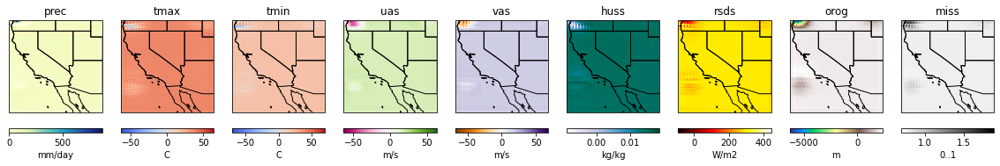

['100000', '0.029279913753271103', '0.06012462452054024']


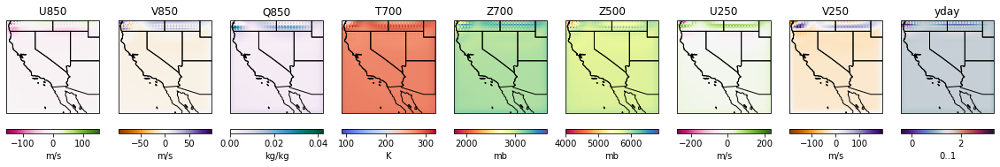

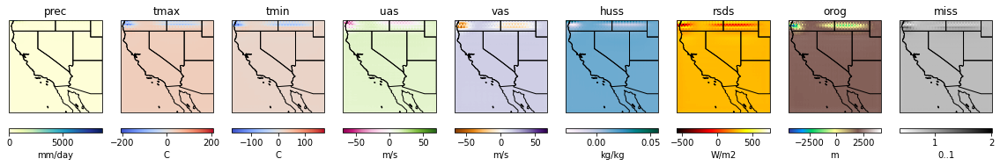

['105000', '0.011835609562695026', '0.017747849225997925']


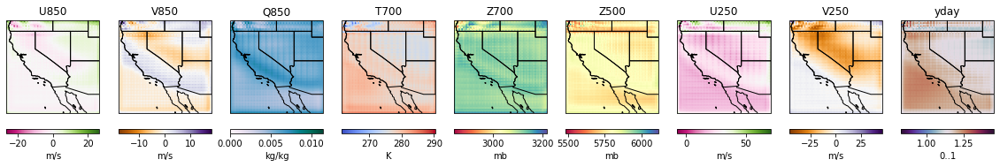

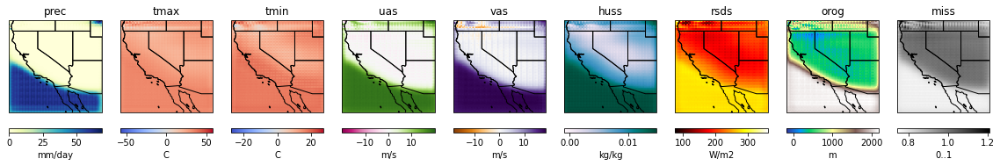

['110000', '0.012613501399755478', '0.018245935440063477']


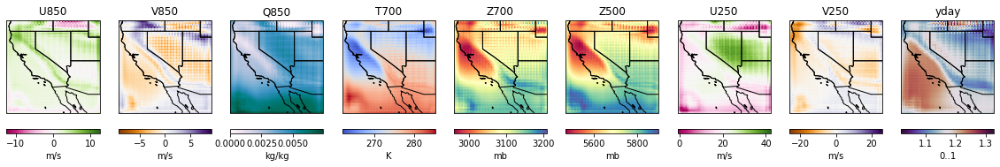

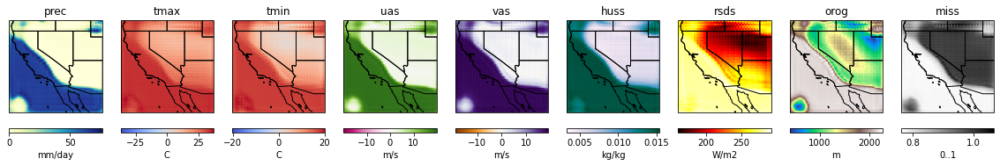

['115000', '0.02127244882285595', '0.03164520487189293']


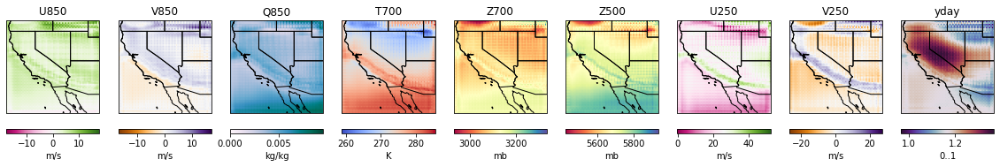

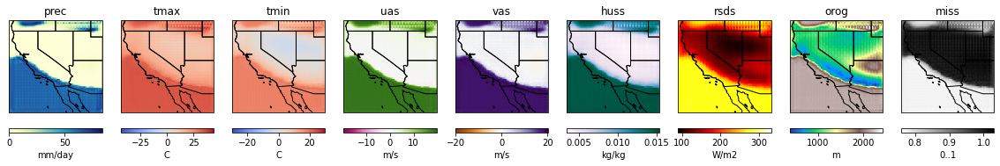

['120000', '0.011214678175747395', '0.01893633045256138']


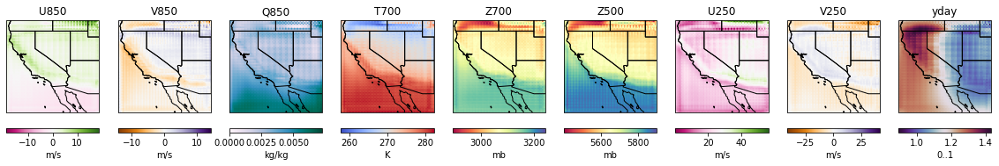

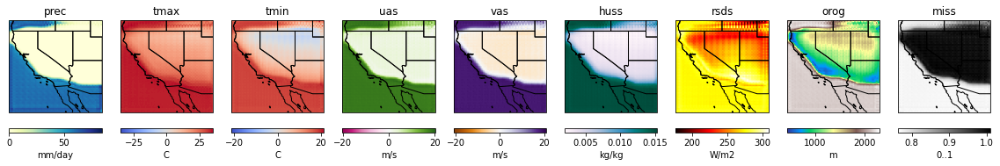

['125000', '0.011713153682649136', '0.006433902774006128']


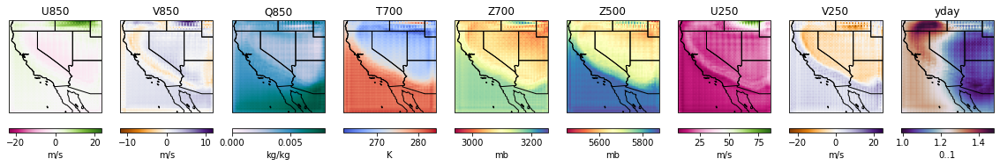

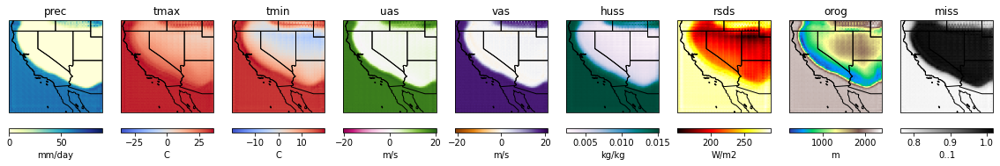

['130000', '0.015382356010377407', '0.006763204000890255']


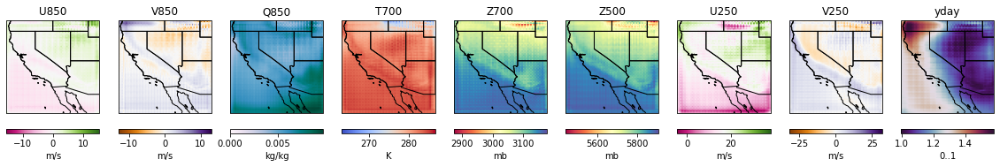

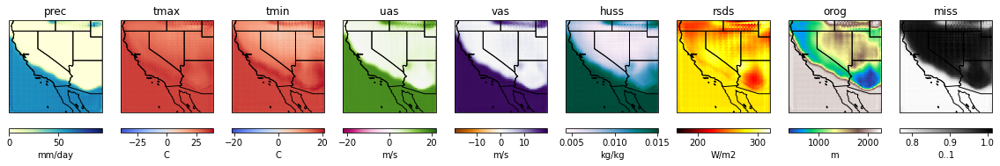

['135000', '0.00616876408457756', '0.004401735495775938']


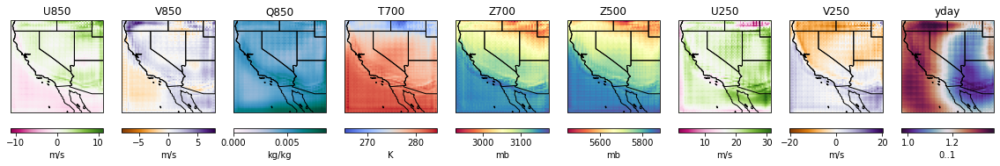

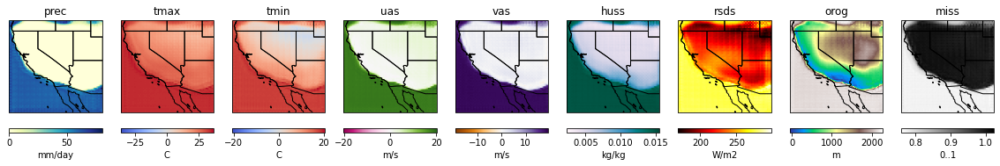

['140000', '0.015033324249088764', '0.010207884013652802']


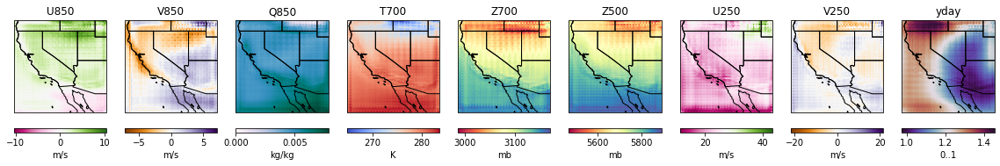

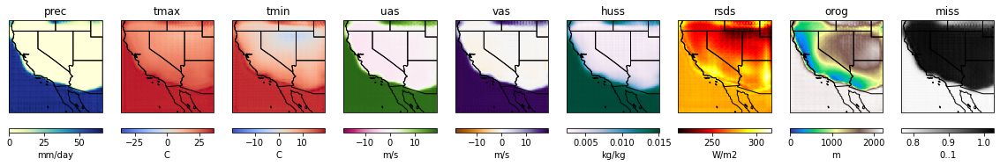

['145000', '0.011386866681277752', '0.012308050878345966']


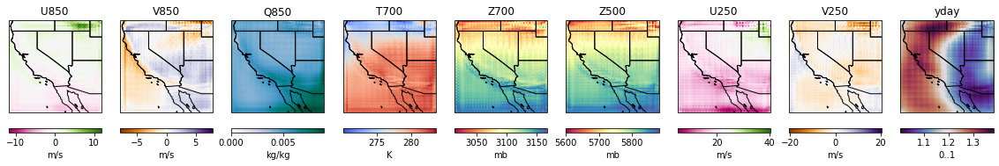

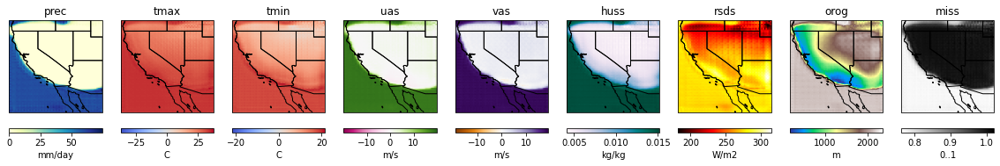

['150000', '0.008728702552616596', '0.009468103758990765']


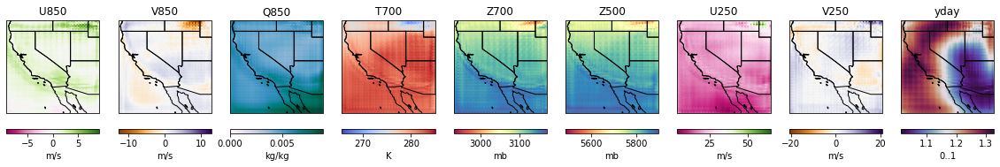

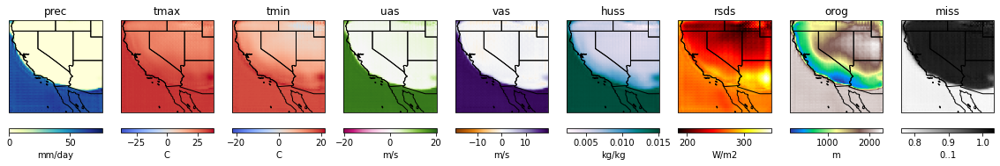

['155000', '0.007752539590001106', '0.006407307926565409']


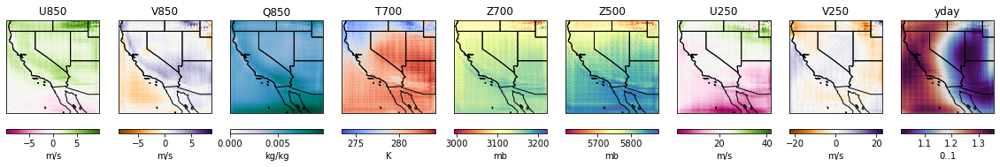

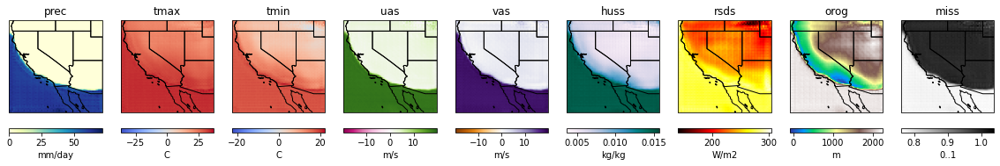

['160000', '0.00577775901183486', '0.0037389928475022316']


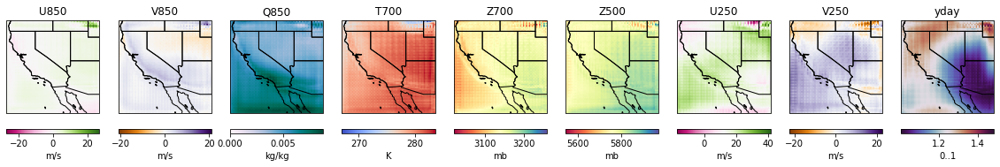

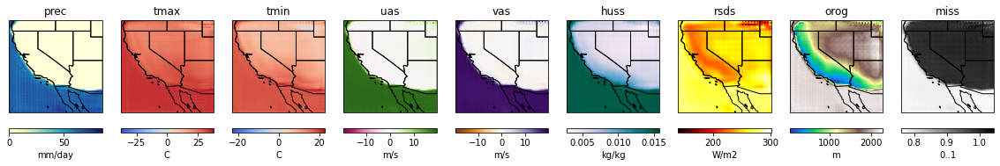

['165000', '0.007756900507956743', '0.006057686172425747']


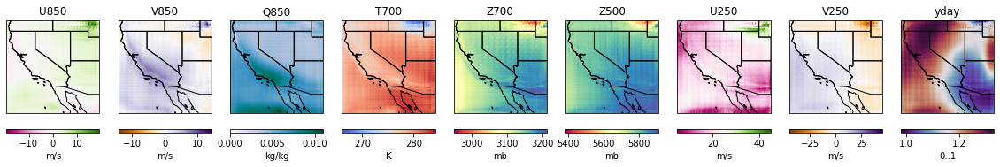

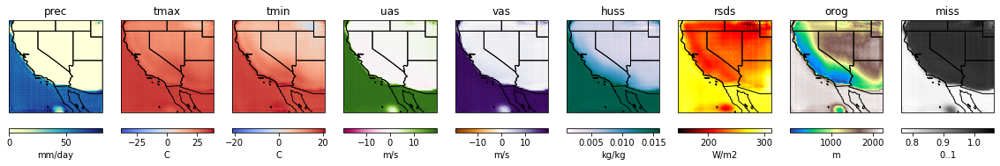

['170000', '0.011002336628735065', '0.003971973899751902']


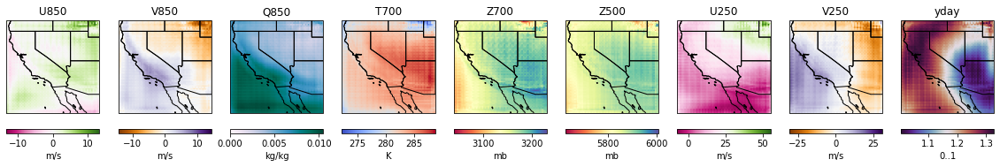

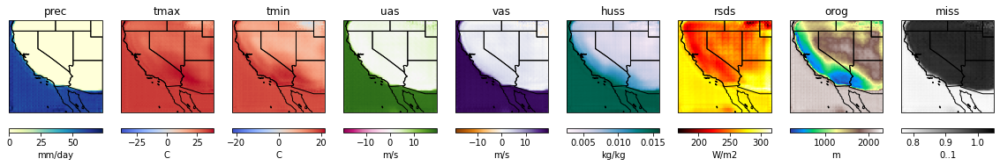

['175000', '0.005962406285107136', '0.003964628092944622']


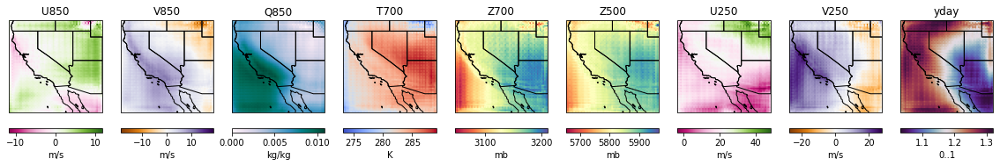

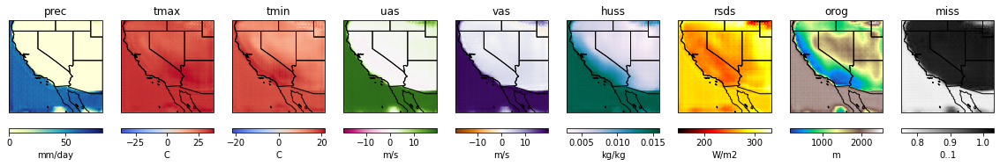

['180000', '0.006771584507077932', '0.004047162365168333']


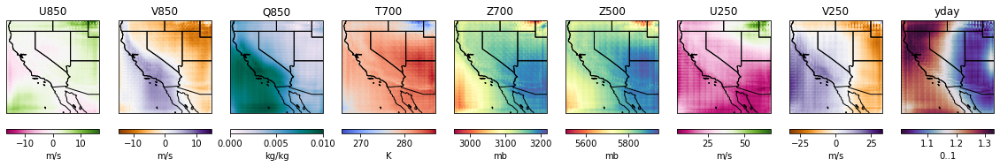

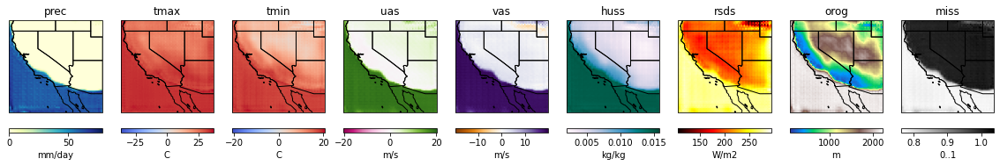

['185000', '0.004221230745315552', '0.0034939770121127367']


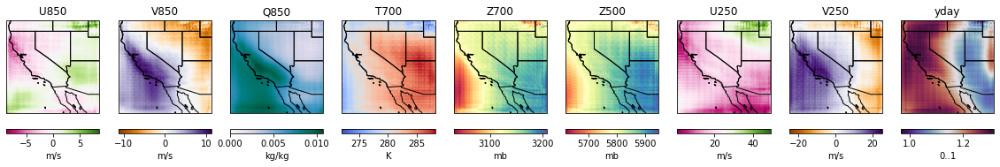

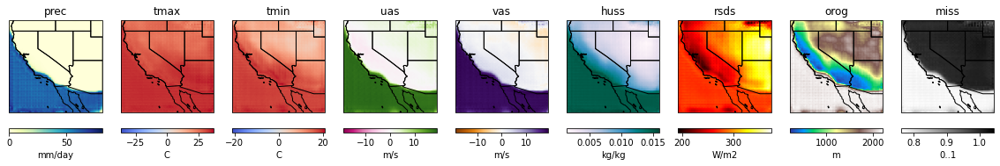

['190000', '0.006305675022304058', '0.00396119337528944']


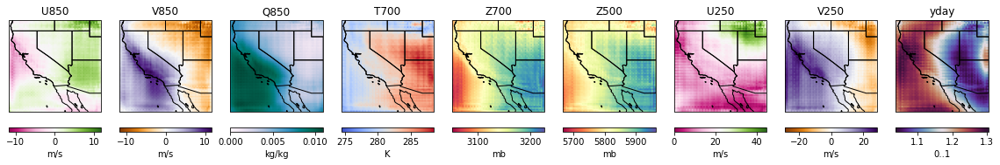

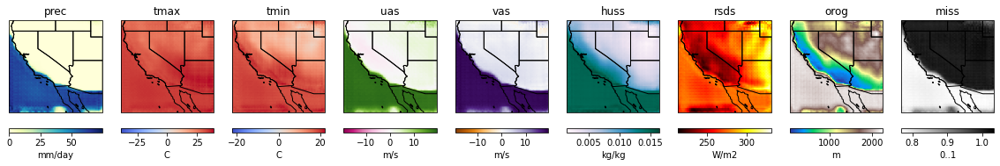

['195000', '0.0035169075708836317', '0.009122073650360107']


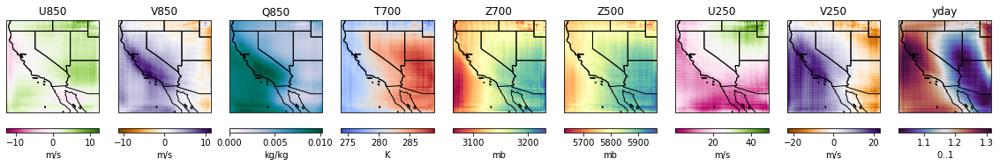

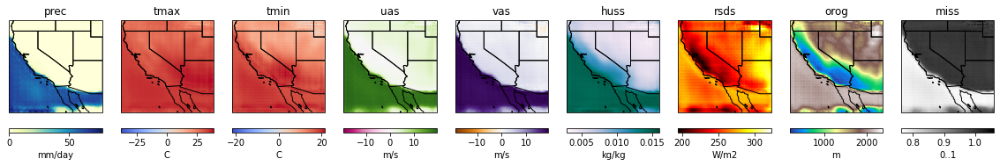

['200000', '0.006908854003995657', '0.005029087420552969']


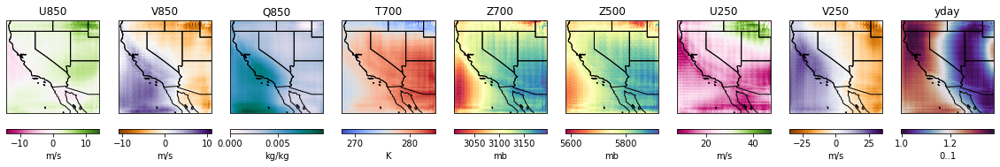

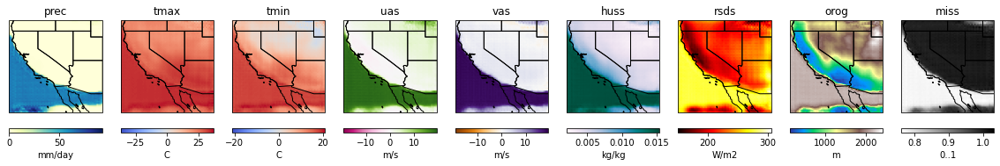

['205000', '0.005289717111736536', '0.003926760517060757']


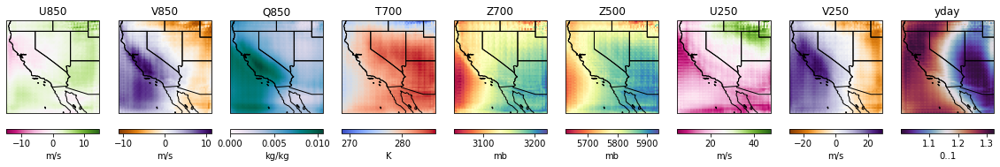

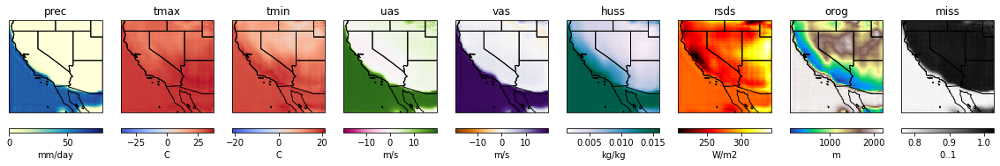

['210000', '0.005871653091162443', '0.005206764675676823']


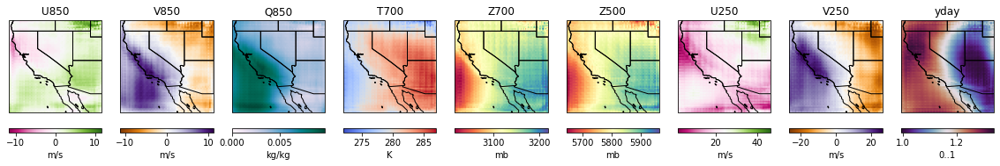

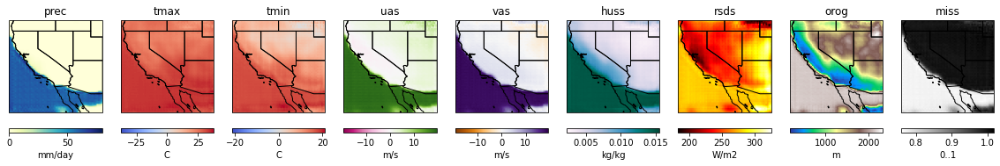

['215000', '0.006039108149707317', '0.004938820842653513']


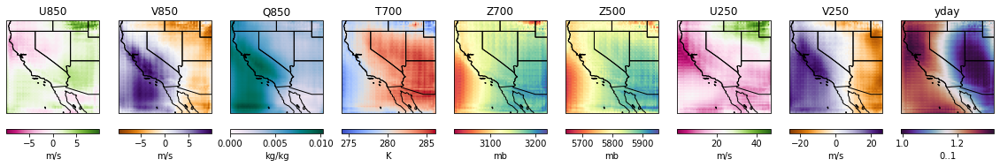

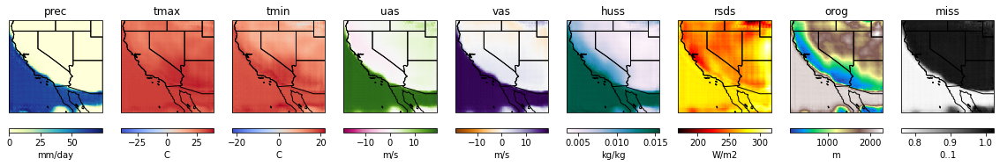

['220000', '0.0061570340767502785', '0.005909007508307695']


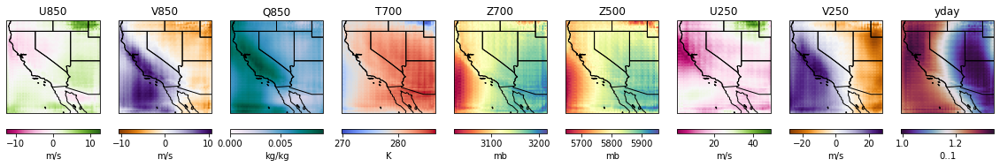

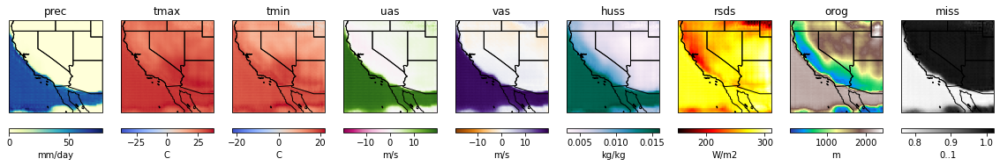

['225000', '0.006381685379892588', '0.00339067867025733']


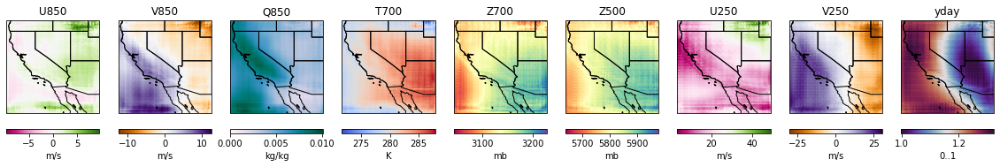

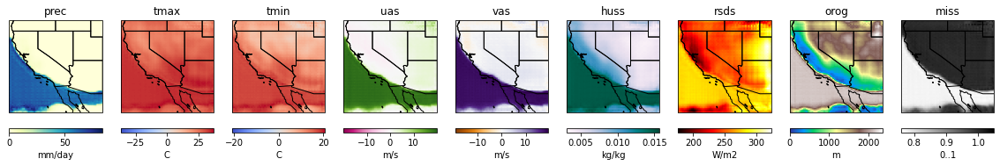

['230000', '0.008121056482195854', '0.006677815690636635']


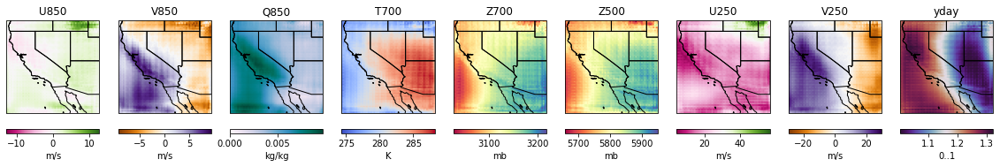

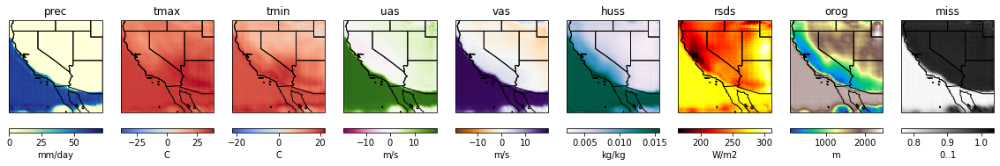

['235000', '0.011690801940858364', '0.0038610477931797504']


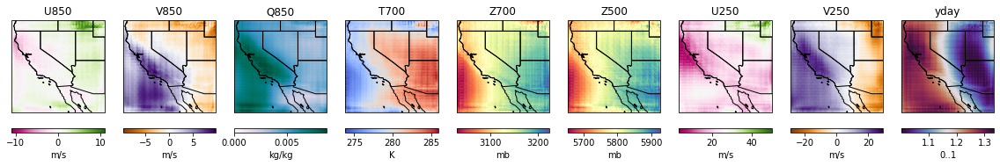

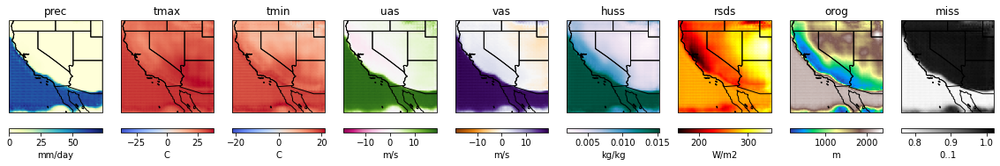

['240000', '0.011047509498894215', '0.0027737680356949568']


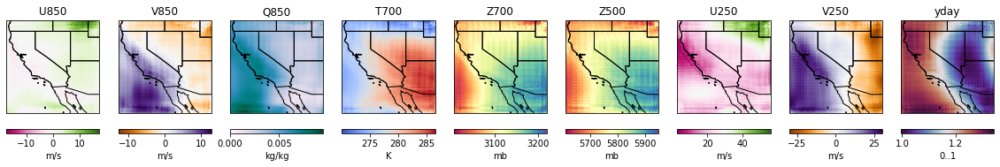

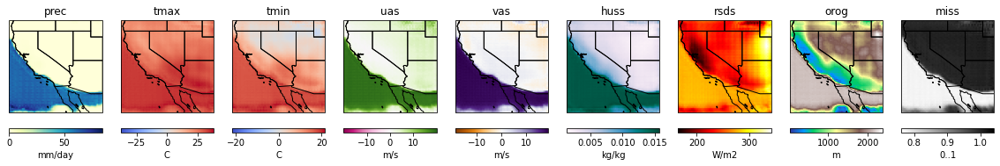

['245000', '0.008440064266324043', '0.0027841750998049974']


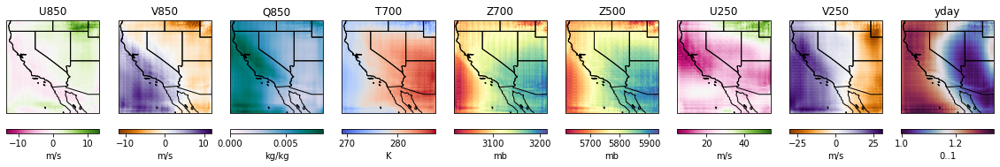

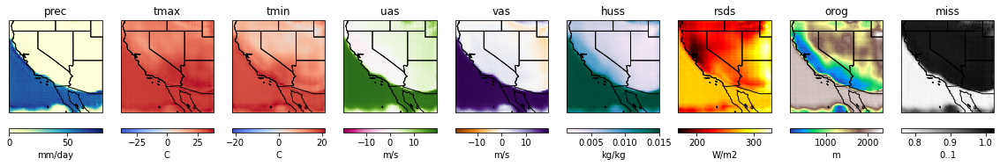

['250000', '0.012334112077951431', '0.003923501819372177']


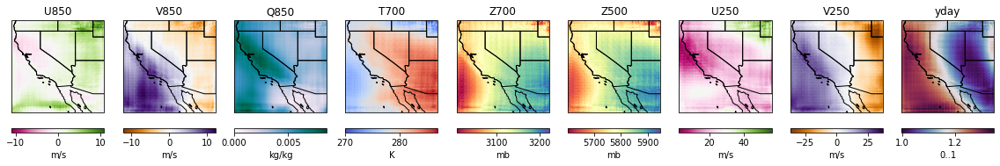

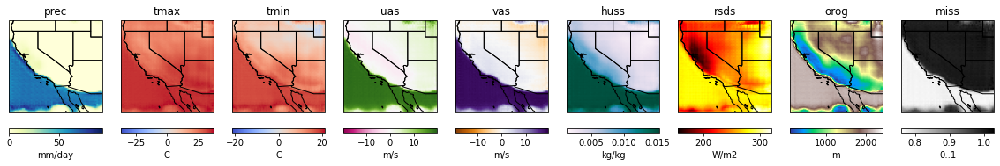

['255000', '0.009203759022057056', '0.005398195702582598']


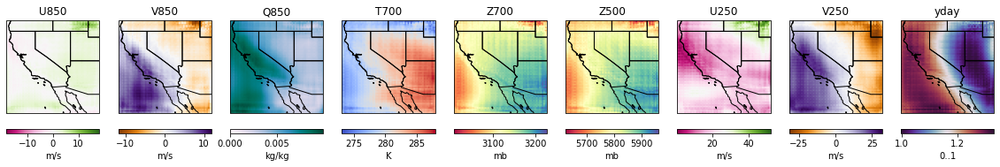

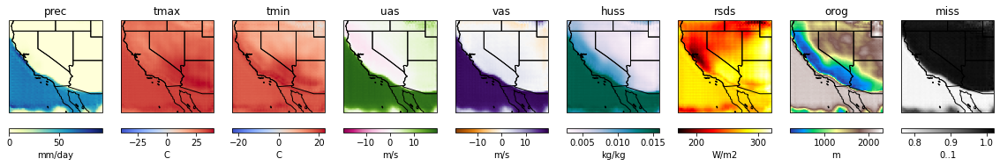

['260000', '0.007214426063001156', '0.003505393397063017']


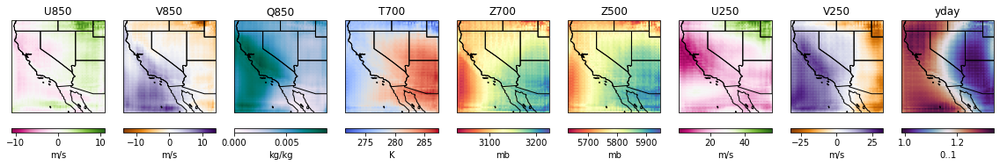

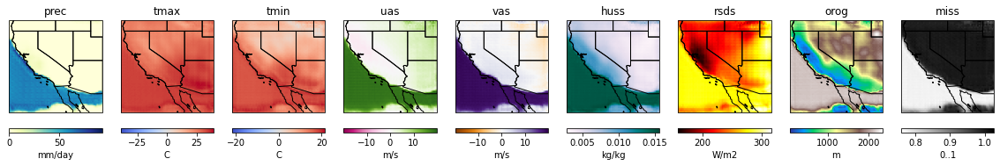

['265000', '0.005246086977422237', '0.008173833601176739']


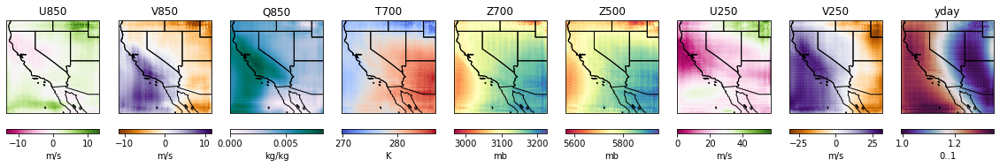

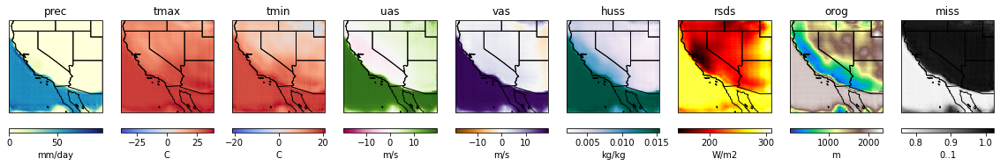

['270000', '0.008504983969032764', '0.0035184696316719055']


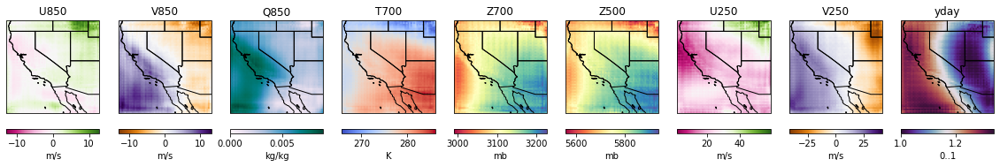

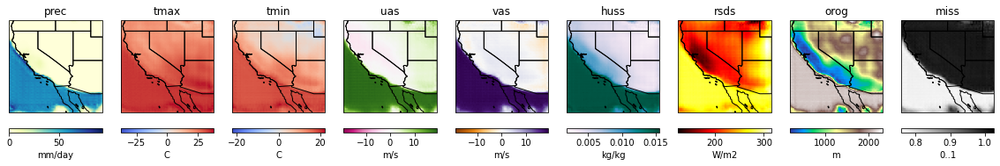

['275000', '0.012357803992927074', '0.007471700664609671']


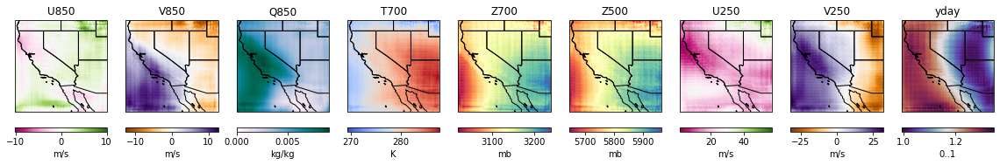

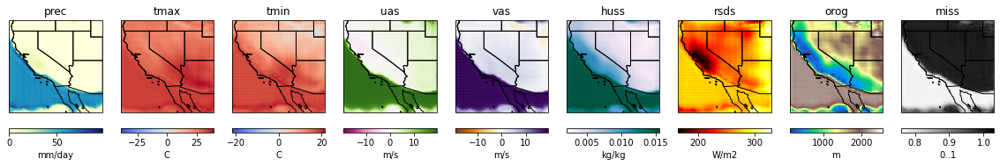

['280000', '0.012144956737756729', '0.005463647656142712']


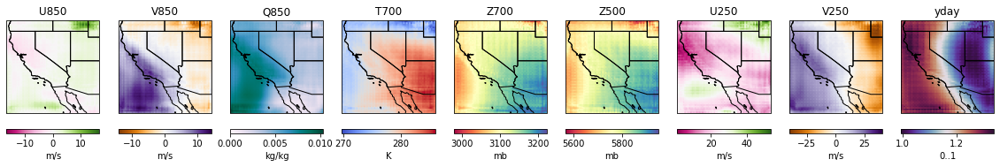

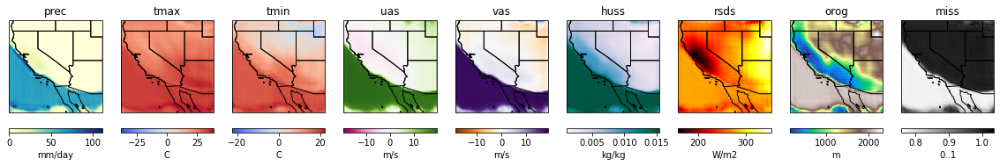

['285000', '0.006027336232364178', '0.003380247624590993']


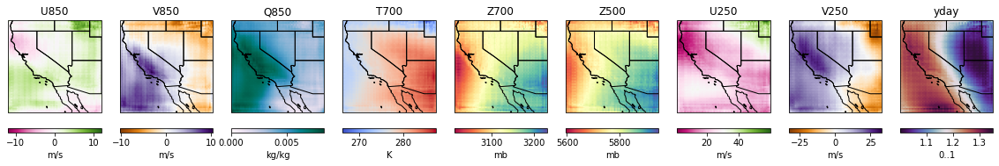

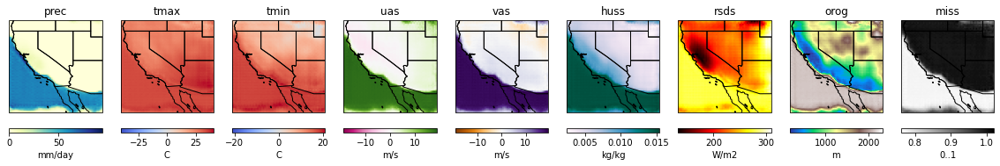

['290000', '0.009666633792221546', '0.008408855646848679']


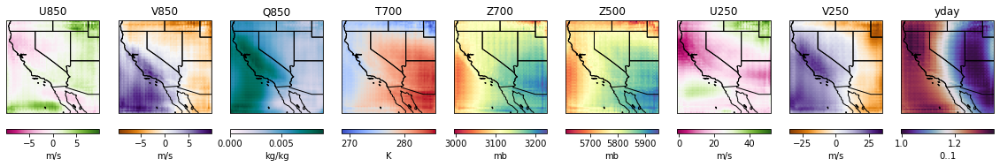

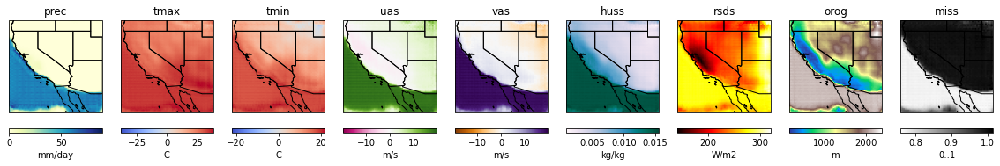

['295000', '0.017179034650325775', '0.0042884391732513905']


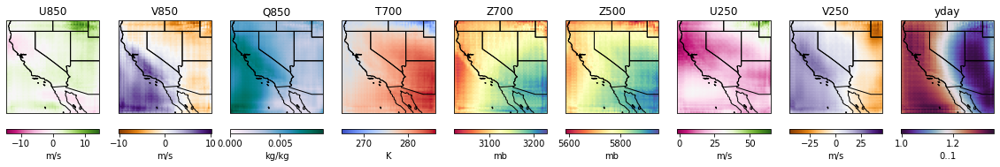

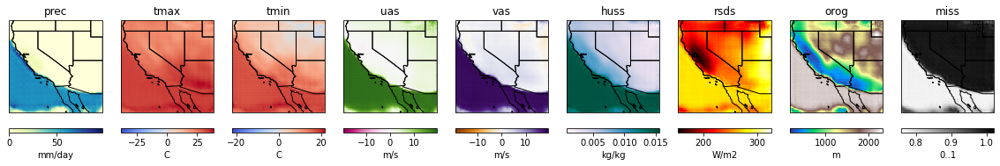

['300000', '0.008240217342972755', '0.0031656366772949696']


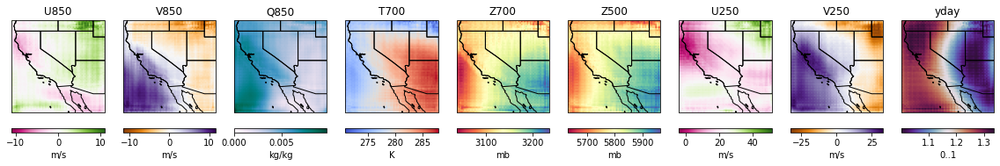

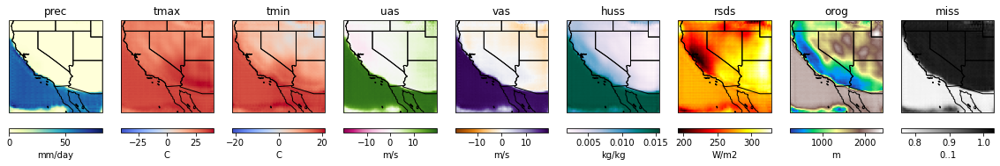

['305000', '0.008266506716609001', '0.0036671061534434557']


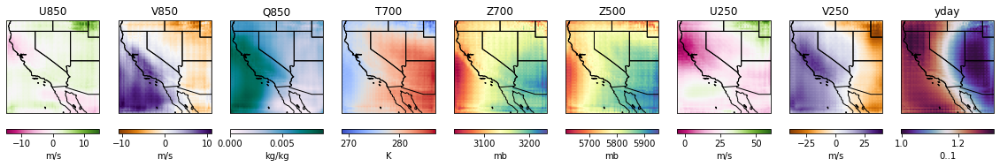

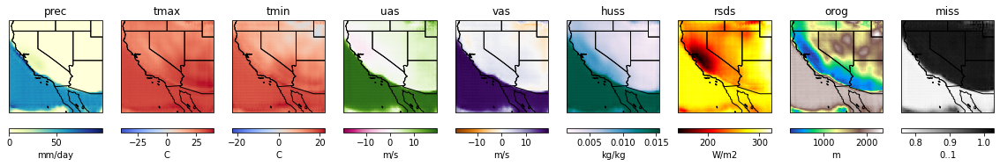

['310000', '0.00910122413188219', '0.004781881347298622']


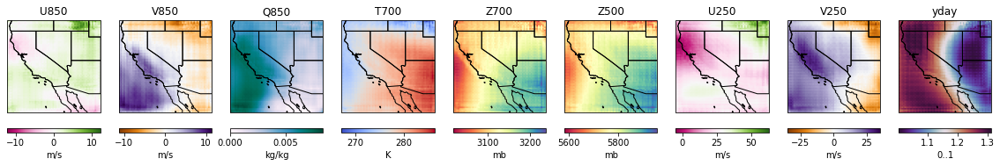

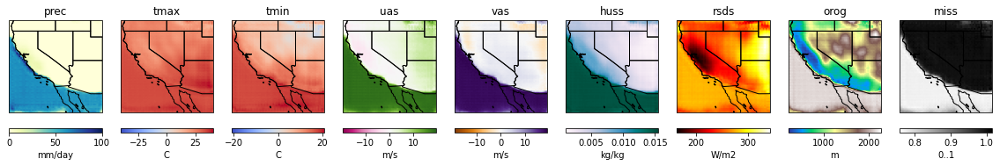

['315000', '0.0083230035379529', '0.004750876221805811']


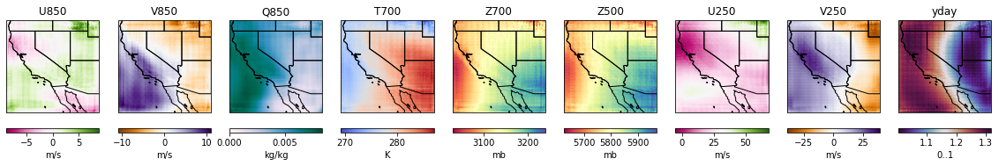

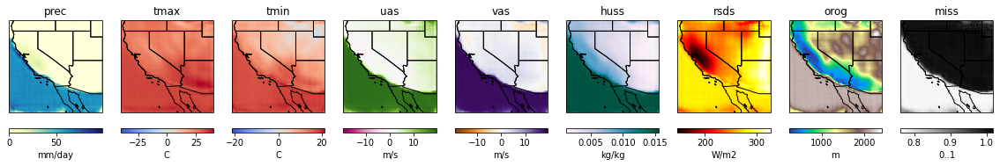

['320000', '0.012716980651021004', '0.003910210449248552']


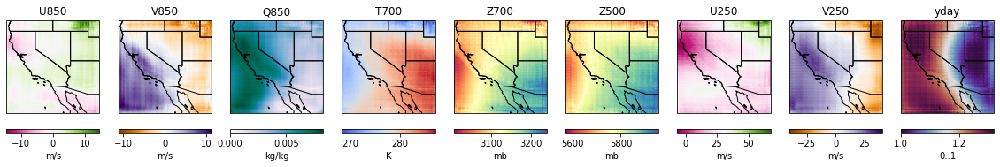

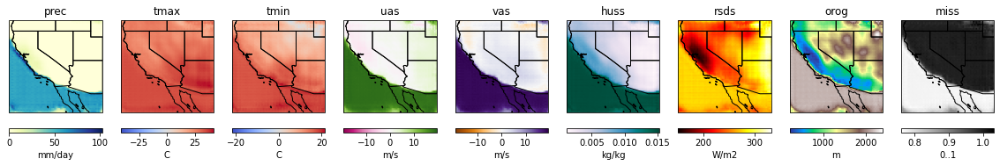

['325000', '0.012152818031609058', '0.003161615924909711']


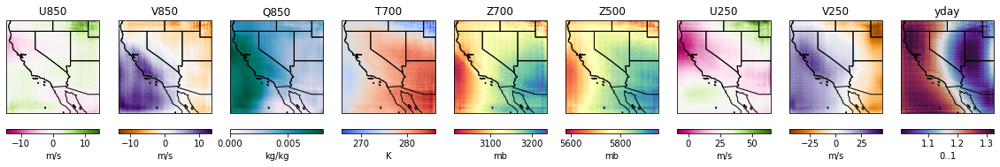

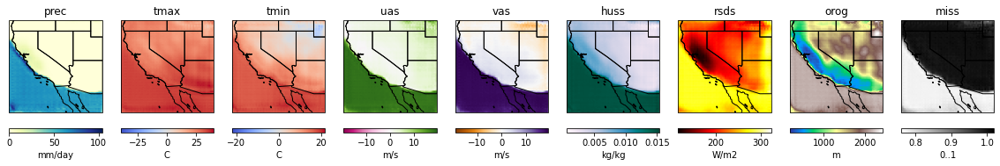

['330000', '0.01899438537657261', '0.0039988174103200436']


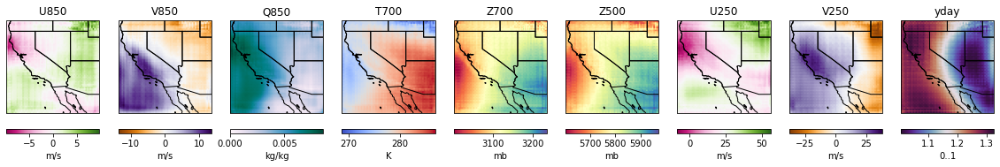

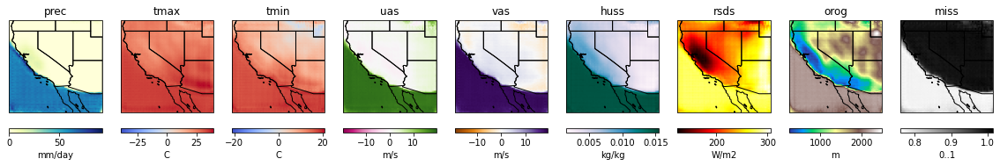

['335000', '0.01291684526950121', '0.006259382702410221']


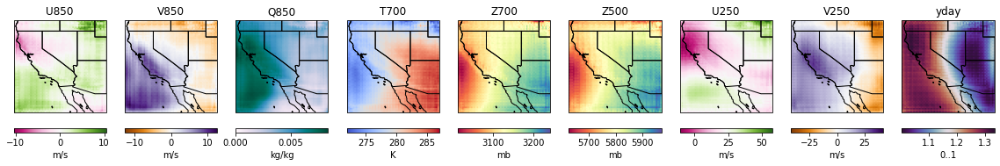

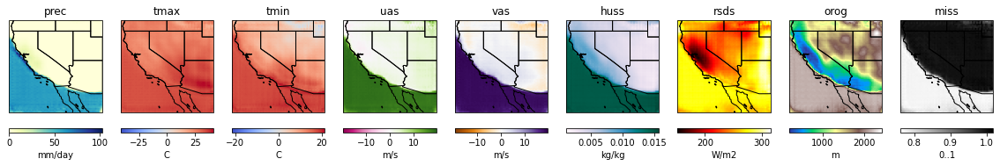

['340000', '0.00991977471858263', '0.00534479133784771']


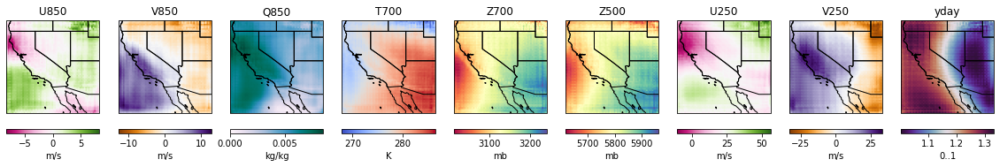

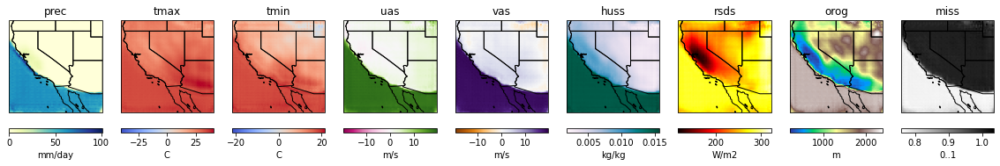

['345000', '0.009380597621202469', '0.007170509081333876']


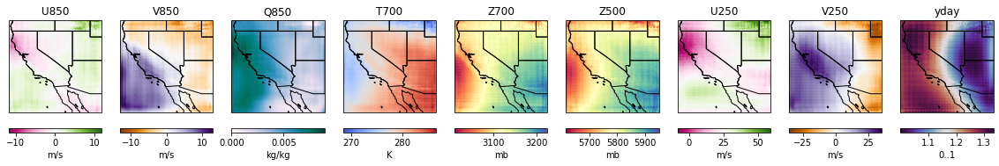

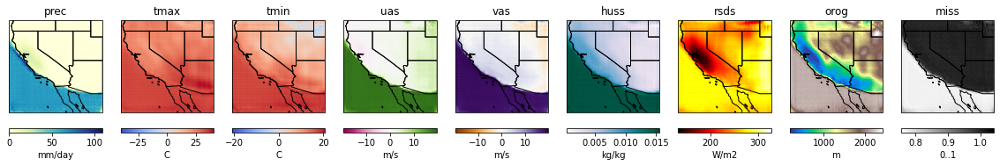

['350000', '0.00792669877409935', '0.0029191940557211637']


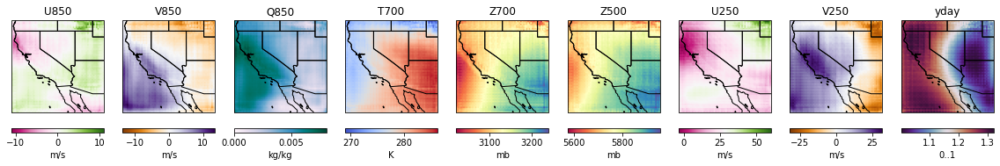

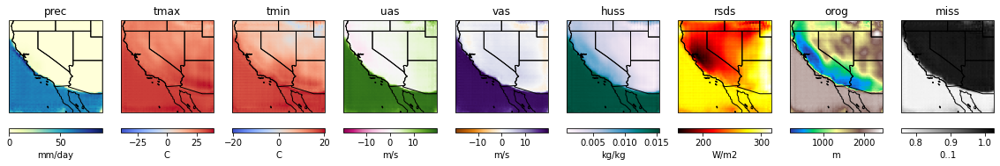

['355000', '0.023608751595020294', '0.0037889177910983562']


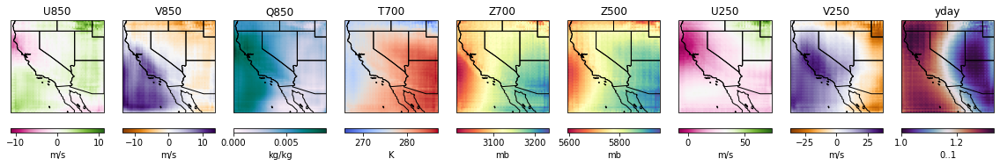

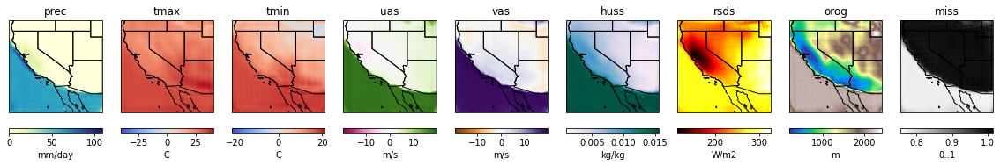

['360000', '0.013144652359187603', '0.007029212079942226']


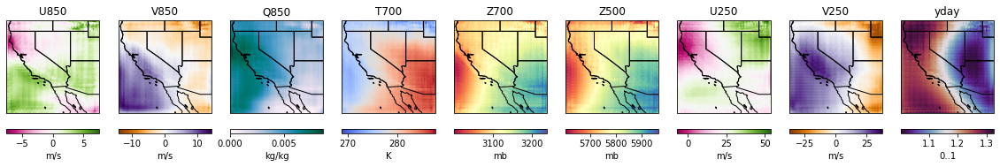

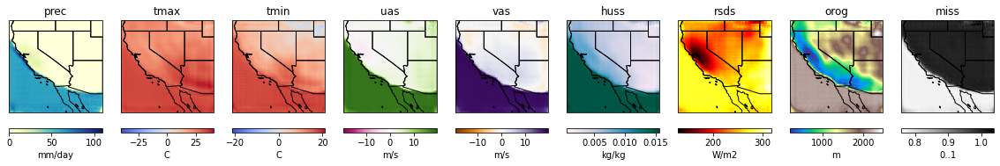

['365000', '0.014720923267304897', '0.004206903278827667']


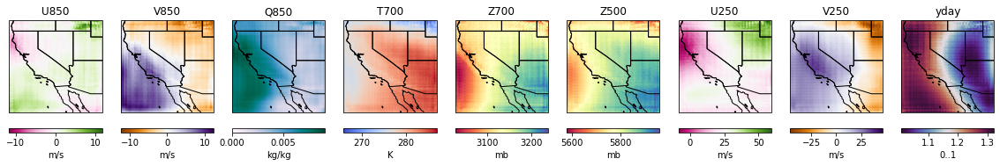

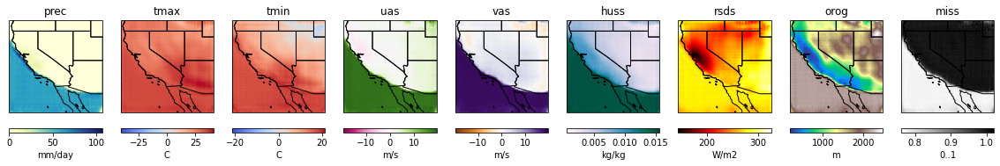

['370000', '0.013455888256430626', '0.004325530491769314']


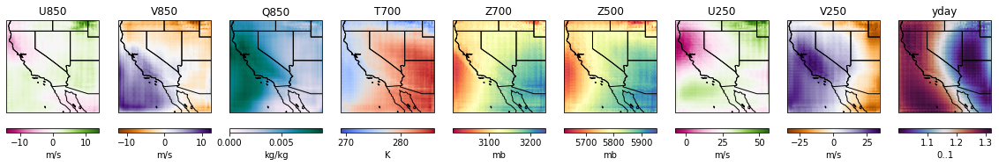

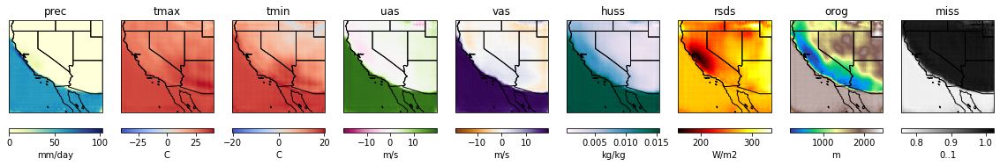

['375000', '0.009976238943636417', '0.0035286869388073683']


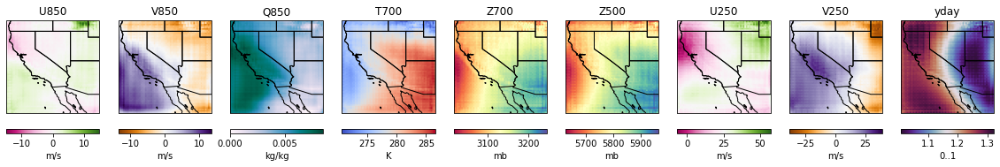

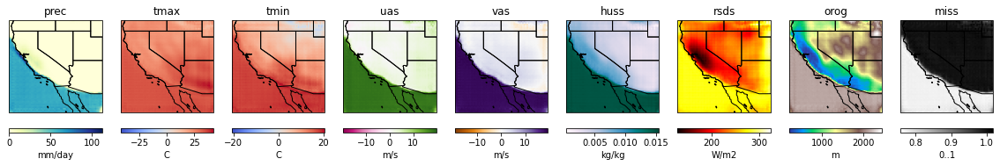

['380000', '0.026848146691918373', '0.005162111017853022']


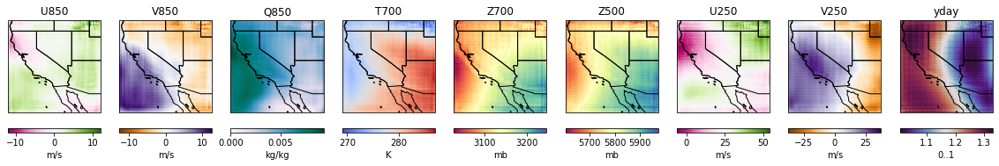

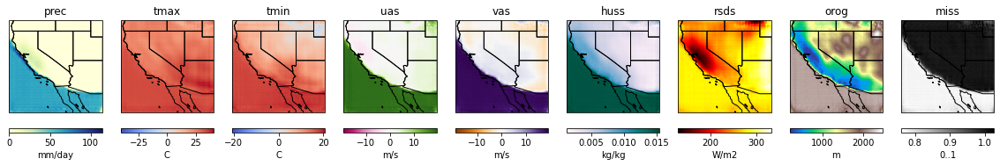

['385000', '0.011214441619813442', '0.007128615397959948']


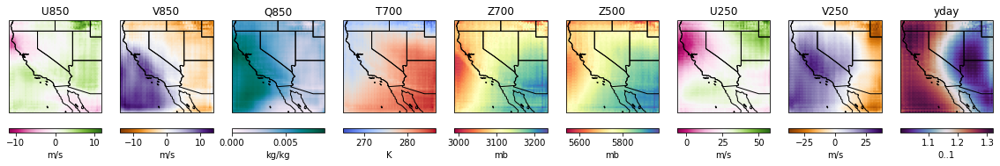

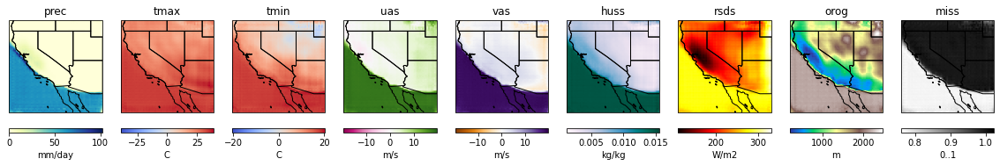

In [50]:
# Open the CSV file for reading
with open('/glade/scratch/dkorytin/unit-wnet-wrferaext18-meanhalf-trainer-3resblks-3ds-bse-dropout/output/mse.csv', 'r') as file:
    # Create a CSV reader object
    csv_reader = csv.reader(file)

    # Loop over each line in the CSV file
    for row in csv_reader:
        # `row` is a list representing the values in the current row
        print(row)  # Example: print the row data
        ii, mpi_mse, era_mse = row

        #padded_str = str(ii).zfill(6)
        padded_str = str(ii)

        ## Load numpy file
        arr = np.load('/glade/scratch/dkorytin/unit-wnet-wrferaext18-meanhalf-trainer-3resblks-3ds-bse-dropout/output/ii_'+padded_str+'_era.npy')

        ## 0 mean
        #arr += era_mean.reshape((1, 18, 1, 1))

        # 0.5 mean
        arr += (era_mean.reshape((1, 18, 1, 1)) + 0.5)

        show_saved_reconstruction(0, arr)